# Project 1: Sex Differences in brain organization

### Main Script: ALL

## Load packages

In [1]:
# General
import os
import sys
import numpy as np
import pandas as pd
import csv
import math
from math import isnan
import statistics
import pingouin as pg
import pickle

# Computing / Analyses
import scipy.io  # loadmat
from scipy import stats
import sklearn 
from brainstat.stats.terms import FixedEffect
from brainstat.stats.SLM import SLM
from statsmodels.stats.multitest import fdrcorrection # does not yield exactly the same FDR correction as R but the same up to 14th decimal place so good enough

# Visualisation
import matplotlib.pyplot as plt 
import seaborn as sns
import vtk
from IPython.display import display
import matplotlib.collections as clt
import ptitprince as pt

# Neuroimaging
import nibabel
import nilearn
from brainstat.datasets import fetch_parcellation
from enigmatoolbox.permutation_testing import spin_test, shuf_test

# Gradients
import brainspace
from brainspace.datasets import load_parcellation, load_conte69
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.utils.parcellation import map_to_labels

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/outdated/utils.py:14: OutdatedPackageWarning: The package pingouin is out of date. Your version is 0.5.2, the latest is 0.5.3.
Set the environment variable OUTDATED_IGNORE=1 to disable these warnings.
  return warn(


## Define directories

In [2]:
codedir = os.path.abspath('')  # obtain current direction from which script is runnning

datadir = '/data/p_02667/sex_diff_gradients/data/'

resdir_gsp = '/data/p_02667/sex_diff_gradients/results/GSP/'
resdir_hcp = '/data/p_02667/sex_diff_gradients/results/HCP/'
resdir_fig = '/data/p_02667/sex_diff_gradients/results/figures/'

## Import functions

In [3]:
%run p1_myfunctions.ipynb

# Data 

## Import the Yeo 7 network coding for the Schaefer 400 parcellation scheme 

(i.e., which network each parcel belongs to)



- **So a parcel cannot belong to more than 1 network..? LIMITATION NO? -> Yes. Shanmugan et al. (2022) for example use loading onto a network (i.e., not discrete)** 

In [4]:
# labels: 1=visual, 2=sensory motor, 3=dorsal attention, 4=ventral attention, 5=limbic, 6=fronto parietal, 7= DMN

with open(datadir+'yeo_7.csv') as f:
    reader = csv.reader(f)
    yeo7_networks = list(reader)[0]  # need [0] because the network values are contained in double brackets [[ ]]

Plotting the 7 Yeo networks on cortical surface

**TO DO:**
- no option of a map with 7 colors..? https://matplotlib.org/stable/tutorials/colors/colormaps.html
- there must be a better way of labelling the maps with actual names of networks (ie categorical)? maybe not, not the purpose of this plot hemispheres function


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


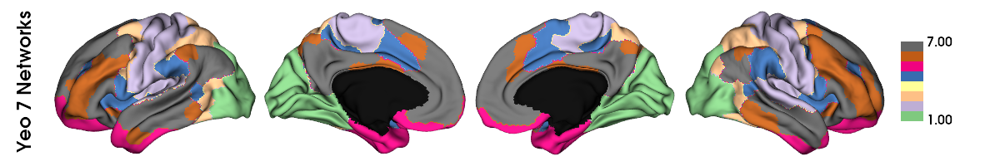

In [5]:
# need the the yeo network values (=dummy coding) to be in array format & float type in order to map_to_labels
yeo7_networks_array = []

for i in yeo7_networks:
    yeo7_networks_array.append(float(i))

yeo7_networks_array = np.asarray(yeo7_networks_array)



# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()

mask = labeling != 0

networks = map_to_labels(yeo7_networks_array, labeling, mask=mask, fill=np.nan)  # mean_grad contains 10 .gradients_ (1 gradient per column) - here I take all rows and individual select column based on gradient I want (first 3)

plot_hemispheres(surf_lh, surf_rh, array_name=networks, embed_nb = True, size=(1200, 200), cmap='Accent', color_bar=True, label_text=['Yeo 7 Networks'], zoom=1.55)


## Network labels ('Accent' cmap):
# 1 visual (green)
# 2 sensory motor (purple)
# 3 dorsal attention (beige)
# 4 ventral attention (blue)
# 5 limbic (fuchsia)
# 6 fronto parietal (brown)
# 7 DMN (grey)

This palette is to be used for every time that Yeo networks are displayed in color (except (a) for showing the networks plotted on the hemispheres - this dictionary doesn't work as cmap for plot_hemispheres; (b) the pie charts - dictionary format not recognized)

In [6]:
# original Yeo network colors
palette_labeled_networks = {'DMN': 'indianred',  
                            'dorsal attention' : 'forestgreen',  
                            'fronto parietal' : 'orange',  
                            'limbic' : 'lemonchiffon',  
                            'sensory motor' : 'steelblue',
                            'ventral attention' : 'orchid', 
                            'visual' : 'darkorchid'} 

This is not needed for the raincloud plot, just for the scatterplot G1 v G2 displaying networks

In [7]:
# making an array with yeo network labels (names instead of numbers)
yeo7_networks_array_labels = []

for i in yeo7_networks:
    if i == '1':
        yeo7_networks_array_labels.append('visual')
    elif i == '2':
        yeo7_networks_array_labels.append('sensory motor')
    elif i == '3':
        yeo7_networks_array_labels.append('dorsal attention')
    elif i == '4':
        yeo7_networks_array_labels.append('ventral attention')
    elif i == '5':
        yeo7_networks_array_labels.append('limbic')
    elif i == '6':
        yeo7_networks_array_labels.append('fronto parietal')
    elif i == '7':
        yeo7_networks_array_labels.append('DMN')

yeo7_networks_array_labels = np.asarray(yeo7_networks_array_labels)

In [8]:
network_names = ["visual", "sensory motor", "DMN", "dorsal attention", "ventral attention", "limbic", "fronto parietal"]

print("Number of parcels in each Yeo network:")
for i in range(len(network_names)):
    print(f"- {network_names[i]}: {yeo7_networks_array_labels.tolist().count(network_names[i])}")

Number of parcels in each Yeo network:
- visual: 61
- sensory motor: 77
- DMN: 90
- dorsal attention: 46
- ventral attention: 47
- limbic: 26
- fronto parietal: 53


## Fetch fsaverage parcellation (20484 vertices) coded for Schaefer 400 parcels - for Spin permutation tests

Spin permutation testing: https://enigma-toolbox.readthedocs.io/en/latest/pages/08.spintest/index.html -> requires data to be in fsaverage surface (not feasible with Schaefer parcellation)

**NOTE: schaefer_400_fs5 == 0 corresponds to midline (labels go from 0-400) -> disregard 0 in calculations and plotting**

In [9]:
# fetch the fsaverage parcellation labeling each of fsaverage5's 20484 vertices with its corresponding Schaefer parcel
schaefer_400_fs5 = fetch_parcellation("fsaverage5", "schaefer", 400)

## Descriptive HCP

### Load data

In [10]:
restricted_data = pd.read_csv(datadir+'RESTRICTED_wanb_9_29_2020_2_14_36.csv')  # contains ACTUAL age, race, ethnicity, handedness, income, education, menstrual cycle info
print(f'Sample with demographic (restricted) data: N = {len(restricted_data)}')

#restricted_data.keys()
#for i in restricted_data.keys():
#    print(i)

unrestricted_data = pd.read_csv(datadir+'unrestricted_wanb_9_14_2020_7_53_51.csv')  # sex ('gender'), BINNED age (in 5-year increments, 22-25, 26-30, 31-35, 35+), ICV ('FS_IntraCranial_Vol')
print(f'Sample with demographic (unrestricted) data: N = {len(unrestricted_data)}')

#unrestricted_data.keys
#for i in unrestricted_data.keys():
#    print(i)

Sample with demographic (restricted) data: N = 1206
Sample with demographic (unrestricted) data: N = 1206


### Creating a merged demographic dataframe (from restricted and unrestricted data)

In [11]:
# merge based on index of both left dataset (unrestricted) and right dataset (restricted)
HCP_demographics_merged = pd.merge(restricted_data, unrestricted_data, left_index=True, right_index=True)

HCP_demographics_merged = HCP_demographics_merged.rename(columns={"Subject_x": "Subject"})

In [12]:
HCP_demographics_merged

,Subject,Age_in_Yrs,HasGT,ZygositySR,ZygosityGT,Family_ID,Mother_ID,Father_ID,TestRetestInterval,Race,...,Noise_Comp,Odor_Unadj,Odor_AgeAdj,PainIntens_RawScore,PainInterf_Tscore,Taste_Unadj,Taste_AgeAdj,Mars_Log_Score,Mars_Errs,Mars_Final
0,100004,24,True,NotTwin,,52259_82122,52259,82122,NaN,White,...,5.2,101.12,86.45,2.0,45.9,107.17,105.31,1.80,0.0,1.80
1,100206,27,True,NotTwin,,56037_85858,56037,85858,NaN,White,...,6.0,108.79,97.19,1.0,49.7,72.63,72.03,1.84,0.0,1.84
2,100307,27,True,NotMZ,MZ,51488_81352,51488,81352,NaN,White,...,3.6,101.12,86.45,0.0,38.6,71.69,71.76,1.76,0.0,1.76
3,100408,33,True,MZ,MZ,51730_81594,51730,81594,NaN,White,...,2.0,108.79,98.04,2.0,52.6,114.01,113.59,1.76,2.0,1.68
4,100610,27,True,NotMZ,DZ,52813_82634,52813,82634,NaN,White,...,2.0,122.25,110.45,0.0,38.6,84.84,85.31,1.92,1.0,1.88
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1201,992774,35,True,NotTwin,,51345_81210,51345,81210,NaN,White,...,8.4,122.25,111.41,4.0,50.1,107.17,103.55,1.76,0.0,1.76
1202,993675,29,True,NotTwin,,55800_85621,55800,85621,NaN,White,...,0.4,122.25,110.45,0.0,38.6,84.07,84.25,1.80,1.0,1.76
1203,994273,30,True,NotTwin,,52364_82227,52364,82227,NaN,White,...,6.0,122.25,111.41,7.0,63.8,110.65,109.73,1.80,1.0,1.76
1204,995174,25,True,MZ,MZ,55923_85743,55923,85743,NaN,White,...,3.6,88.61,64.58,3.0,50.1,117.16,117.40,1.80,0.0,1.80


### Final list of subjects with all data (FC, MPC, geodesic distance)

#### Load subject lists

In [13]:
HCP_sub_list_fc = pd.read_csv(datadir+'HCP_sub_list_fc.csv', header = None)[0].to_list()
len(HCP_sub_list_fc)

1014

In [14]:
HCP_sub_list_MPC = pd.read_csv(datadir+'HCP_sub_list_MPC.csv', header = None)[0].to_list()
len(HCP_sub_list_MPC)

1093

In [15]:
HCP_sub_list_geodesic = pd.read_csv(datadir+'geodesic_distance/HCP_sub_list_geodesic.csv', header = None)[0].to_list()
len(HCP_sub_list_geodesic)

1010

#### Make a final subject list that has all data (fc, MPC, geodesic distance)

In [16]:
HCP_sub_list_final = set.intersection(set(HCP_sub_list_fc), set(HCP_sub_list_MPC), set(HCP_sub_list_geodesic))
HCP_sub_list_final = list(HCP_sub_list_final)
HCP_sub_list_final.sort()
len(HCP_sub_list_final)

1000

### Final demographics dataframe including subjects  with all data (FC, MPC, geodesic distance)

In [17]:
# take a subset of the demographics dataframe - i.e., only subjects belonging to the final subjects list
HCP_demographics_cleaned = HCP_demographics_merged[HCP_demographics_merged["Subject"].isin(HCP_sub_list_final)]

In [18]:
HCP_demographics_cleaned

,Subject,Age_in_Yrs,HasGT,ZygositySR,ZygosityGT,Family_ID,Mother_ID,Father_ID,TestRetestInterval,Race,...,Noise_Comp,Odor_Unadj,Odor_AgeAdj,PainIntens_RawScore,PainInterf_Tscore,Taste_Unadj,Taste_AgeAdj,Mars_Log_Score,Mars_Errs,Mars_Final
1,100206,27,True,NotTwin,,56037_85858,56037,85858,NaN,White,...,6.0,108.79,97.19,1.0,49.7,72.63,72.03,1.84,0.0,1.84
2,100307,27,True,NotMZ,MZ,51488_81352,51488,81352,NaN,White,...,3.6,101.12,86.45,0.0,38.6,71.69,71.76,1.76,0.0,1.76
3,100408,33,True,MZ,MZ,51730_81594,51730,81594,NaN,White,...,2.0,108.79,98.04,2.0,52.6,114.01,113.59,1.76,2.0,1.68
4,100610,27,True,NotMZ,DZ,52813_82634,52813,82634,NaN,White,...,2.0,122.25,110.45,0.0,38.6,84.84,85.31,1.92,1.0,1.88
5,101006,35,True,MZ,,51283_52850_81149,51283,81149,NaN,Black or African Am.,...,6.0,122.25,111.41,0.0,38.6,123.80,123.31,1.80,0.0,1.80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1200,992673,33,True,NotTwin,,56143_85963,56143,85963,NaN,White,...,3.6,122.25,111.41,1.0,38.6,101.63,99.26,1.80,0.0,1.80
1201,992774,35,True,NotTwin,,51345_81210,51345,81210,NaN,White,...,8.4,122.25,111.41,4.0,50.1,107.17,103.55,1.76,0.0,1.76
1202,993675,29,True,NotTwin,,55800_85621,55800,85621,NaN,White,...,0.4,122.25,110.45,0.0,38.6,84.07,84.25,1.80,1.0,1.76
1203,994273,30,True,NotTwin,,52364_82227,52364,82227,NaN,White,...,6.0,122.25,111.41,7.0,63.8,110.65,109.73,1.80,1.0,1.76


#### adding variables to the dataframe

##### creating and adding to the demographics dataframe a numerical variable for sex (for including sex as a covariate in partial correlation, throws error if include 'M' 'F' lables)

In [19]:
sex_num = []


for sex_letter in HCP_demographics_cleaned.Gender:
    
    if sex_letter == 'M':
        sex_num.append(0)
        
    elif sex_letter == 'F':
        sex_num.append(1)
        
    else:  # just in case, but there are none
        sex_num.append('n/a') 

HCP_demographics_cleaned['sex_num'] = sex_num

/tmp/ipykernel_51336/2970297418.py:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HCP_demographics_cleaned['sex_num'] = sex_num


##### Creating a variable describing twin status (MZ, DZ, sibling, unrelated)
This is for linear mixed effect model -> controling for family and twin status 

In [20]:
### Make a list containing the family IDs that have multiple siblings

HCP_family_IDs = []  # contains all family IDs (without duplicates)
HCP_family_IDs_related = []  # contains family IDs of subjects that have relatives in sample ("duplicated" family IDs) - each ID appearing only 1x

# loop over all subjects
for i in range(len(HCP_demographics_cleaned)):
   
    # conditions to append family ID in HCP_family_IDs_related df:
    # if the current sub's family ID is already in the HCP_family_IDs, it means that we have looped over this family ID before therefore there are siblings sharing this family_ID in the dataset; AND
    # because we don't want duplicate family IDs in HCP_family_IDs_related: if the current sub's family ID is not yet in HCP_family_IDs_related -> we need to append it
    if (HCP_demographics_cleaned.Family_ID.iloc[i] in HCP_family_IDs) & (HCP_demographics_cleaned.Family_ID.iloc[i] not in HCP_family_IDs_related):
        HCP_family_IDs_related.append(HCP_demographics_cleaned.Family_ID.iloc[i])
    
    if HCP_demographics_cleaned.Family_ID.iloc[i] not in HCP_family_IDs: 
        HCP_family_IDs.append(HCP_demographics_cleaned.Family_ID.iloc[i])
        
        
        
### create a list containing (in order of participants) those that have other family members in the sample based on their family ID (if it is present in list HCP_family_IDs_related)

family_members_in_sample = []

for i in HCP_demographics_cleaned['Family_ID'] :
    if i in HCP_family_IDs_related:
        family_members_in_sample.append(1)
    else:
        family_members_in_sample.append(0)



### create a new variable variable that specifies the twin status (i.e., MZ, DZ, sibling, unrelated)
# based on family_members_in_sample and Zygosity variables 
    # ZygosityGT (determined via genotyping) should be given precedence over ZygositySR (self-reported) 
    # Genotyping was only done when both subjects in a twin pair to have HasGT=TRUE to have a value (if genotyping is not available for either of a twin pair, no values are given for ZygosityGT)
    # Non-twin subjects also do not have a value for ZygosityGT
    # Note that some subjects self-reported as dizygotic twins (ZygositySR='NotMZ') but genotyping established that they were monozygotic twins (thence ZygosityGT='MZ' for those subjects)
    # including the empty ZygosityGT condition so that ZygositySR does not override GT    

TwinStatus = []

for i in range(len(HCP_demographics_cleaned)):
    if family_members_in_sample[i] == 1:
        if HCP_demographics_cleaned.ZygosityGT.iloc[i] == 'MZ' or (HCP_demographics_cleaned.ZygosityGT.iloc[i] == ' ' and HCP_demographics_cleaned.ZygositySR.iloc[i] == 'MZ'):
            TwinStatus.append('MZ')
        elif HCP_demographics_cleaned.ZygosityGT.iloc[i] == 'DZ' or (HCP_demographics_cleaned.ZygosityGT.iloc[i] == ' ' and HCP_demographics_cleaned.ZygositySR.iloc[i] == 'NotMZ'):
            TwinStatus.append('DZ')
        else:
            TwinStatus.append('sibling')
    elif family_members_in_sample[i] == 0:
        TwinStatus.append('unrelated')

HCP_demographics_cleaned['TwinStatus'] = TwinStatus



### creating a numerical version of TwinStatus variable (for including TwinStatus as a covariate in partial correlation, throws error if include string lables)
TwinStatus_num = []


for twinstatus_letter in HCP_demographics_cleaned.TwinStatus:
    
    if twinstatus_letter == 'MZ':
        TwinStatus_num.append(0)
        
    elif twinstatus_letter == 'DZ':
        TwinStatus_num.append(1)
    
    elif twinstatus_letter == 'sibling':
        TwinStatus_num.append(2)
    
    elif twinstatus_letter == 'unrelated':
        TwinStatus_num.append(3)

HCP_demographics_cleaned['TwinStatus_num'] = TwinStatus_num
#HCP_demographics_cleaned.TwinStatus_num.value_counts()

/tmp/ipykernel_51336/3645008470.py:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HCP_demographics_cleaned['TwinStatus'] = TwinStatus
/tmp/ipykernel_51336/3645008470.py:75: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HCP_demographics_cleaned['TwinStatus_num'] = TwinStatus_num


In [21]:
# for some reason, the partial correlation does not work when including Family_ID large numbers (10 digits <) as covariate - therefore, here we create new family IDs starting from 1 (whilst of course preserving family relatedness)

# dictionary that will include the correspondance of original IDs and new IDs (only for related individuals, unrelated will be easily numbered on top)
fam_ID_correspondance_dict = {}

for i in range(len(HCP_family_IDs_related)):
    
    # create a new dictionary entry with the original family ID and it's new corresponding family ID (starting with 1 not to make any issue with zero) -> IDs going from 1 to 347 (as there are 347 related families in sample)
    fam_ID_correspondance_dict[HCP_family_IDs_related[i]] = i+1

    
# creating a new variable for dataframe which will contain the new family IDs     
Family_ID_num = []
n = 0  

# iterate over all family IDs
for family_id in HCP_demographics_cleaned.Family_ID:
    
    # if it's a family ID of a family that has related individuals in sample, go fetch its new family ID in the dictionary and append it to the list
    if family_id in HCP_family_IDs_related:
        Family_ID_num.append(fam_ID_correspondance_dict[family_id])
    
    # if it's the family ID of an unrelated individual, create a new family ID by adding n to the len(family_related) (i.e., 347) - n is also being incremented each time we come across an unrelated subject in loop
    else:
        n += 1
        Family_ID_num.append(len(HCP_family_IDs_related)+n) # new family IDs for unrelated individuals

HCP_demographics_cleaned['Family_ID_num'] = Family_ID_num

/tmp/ipykernel_51336/4142279548.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  HCP_demographics_cleaned['Family_ID_num'] = Family_ID_num


#### Final demographics

In [22]:
HCP_demographics_cleaned_final = HCP_demographics_cleaned.copy()

In [23]:
HCP_demographics_cleaned_final

,Subject,Age_in_Yrs,HasGT,ZygositySR,ZygosityGT,Family_ID,Mother_ID,Father_ID,TestRetestInterval,Race,...,PainInterf_Tscore,Taste_Unadj,Taste_AgeAdj,Mars_Log_Score,Mars_Errs,Mars_Final,sex_num,TwinStatus,TwinStatus_num,Family_ID_num
1,100206,27,True,NotTwin,,56037_85858,56037,85858,NaN,White,...,49.7,72.63,72.03,1.84,0.0,1.84,0,sibling,2,115
2,100307,27,True,NotMZ,MZ,51488_81352,51488,81352,NaN,White,...,38.6,71.69,71.76,1.76,0.0,1.76,1,MZ,0,149
3,100408,33,True,MZ,MZ,51730_81594,51730,81594,NaN,White,...,52.6,114.01,113.59,1.76,2.0,1.68,0,MZ,0,38
4,100610,27,True,NotMZ,DZ,52813_82634,52813,82634,NaN,White,...,38.6,84.84,85.31,1.92,1.0,1.88,0,DZ,1,8
5,101006,35,True,MZ,,51283_52850_81149,51283,81149,NaN,Black or African Am.,...,38.6,123.80,123.31,1.80,0.0,1.80,1,MZ,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1200,992673,33,True,NotTwin,,56143_85963,56143,85963,NaN,White,...,38.6,101.63,99.26,1.80,0.0,1.80,1,sibling,2,340
1201,992774,35,True,NotTwin,,51345_81210,51345,81210,NaN,White,...,50.1,107.17,103.55,1.76,0.0,1.76,0,sibling,2,272
1202,993675,29,True,NotTwin,,55800_85621,55800,85621,NaN,White,...,38.6,84.07,84.25,1.80,1.0,1.76,1,sibling,2,341
1203,994273,30,True,NotTwin,,52364_82227,52364,82227,NaN,White,...,63.8,110.65,109.73,1.80,1.0,1.76,0,sibling,2,200


In [24]:
print(f"N = {len(HCP_demographics_cleaned_final)}\n"
      f"{np.sum(HCP_demographics_cleaned_final.Gender == 'F')} females, {np.sum(HCP_demographics_cleaned_final.Gender == 'M')} males\n"
      f"Mean subject age: {np.mean(HCP_demographics_cleaned_final.Age_in_Yrs):.2f}, SD: {np.std(HCP_demographics_cleaned_final.Age_in_Yrs):.2f}, range: {np.min(HCP_demographics_cleaned_final.Age_in_Yrs):.2f} - {np.max(HCP_demographics_cleaned_final.Age_in_Yrs):.2f}\n"
      f"Mean ICV: {np.mean(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f}, SD: {np.std(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f}, range: {np.min(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f} - {np.max(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f}\n"
      f"Sample relatedness: {np.sum(HCP_demographics_cleaned_final.TwinStatus == 'MZ')} MZ twins, {np.sum(HCP_demographics_cleaned_final.TwinStatus == 'DZ')} DZ twins, {np.sum(HCP_demographics_cleaned_final.TwinStatus == 'sibling')} other siblings, {np.sum(HCP_demographics_cleaned_final.TwinStatus == 'unrelated')} unrelated individuals"
     )

N = 1000
536 females, 464 males
Mean subject age: 28.73, SD: 3.71, range: 22.00 - 37.00
Mean ICV: 1584000.48, SD: 187267.82, range: 831208.30 - 2143193.92
Sample relatedness: 284 MZ twins, 184 DZ twins, 443 other siblings, 89 unrelated individuals


#### Export demographics dataframe to csv for R analyses

In [25]:
HCP_demographics_cleaned_final.to_csv(resdir_hcp+'demographics_cleaned_final.csv', header = True, index = True)

### Testing differences in age between the sexes (given that I will test sex differences without matching for age)

In [26]:
# Levene's test for equality of variances -> non-significant differences means equality, can contiunue with parametric independent samples t-test
stats.levene(HCP_demographics_cleaned_final.Age_in_Yrs[HCP_demographics_cleaned_final.Gender == 'M'], HCP_demographics_cleaned_final.Age_in_Yrs[HCP_demographics_cleaned_final.Gender == 'F'])

LeveneResult(statistic=0.09030762176822477, pvalue=0.763849030139735)

In [27]:
stats.ttest_ind(HCP_demographics_cleaned_final.Age_in_Yrs[HCP_demographics_cleaned_final.Gender == 'M'], HCP_demographics_cleaned_final.Age_in_Yrs[HCP_demographics_cleaned_final.Gender == 'F'])

Ttest_indResult(statistic=-6.820637739913875, pvalue=1.5684992753964304e-11)

Text(0, 0.5, 'Frequency')

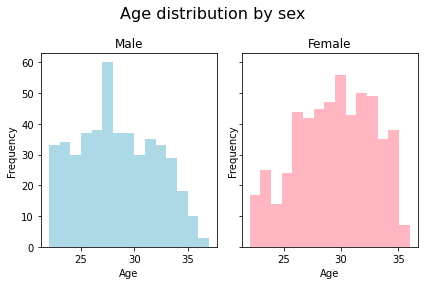

In [28]:
fig, axs = plt.subplots(1, 2, sharey=True, tight_layout=True)

fig.suptitle('Age distribution by sex', fontsize=16)

axs[0].hist(HCP_demographics_cleaned_final.Age_in_Yrs[HCP_demographics_cleaned_final.Gender == 'M'], bins=15, color = 'lightblue')
axs[0].set_title('Male')
axs[0].set_xlabel('Age')
axs[0].set_ylabel('Frequency')

axs[1].hist(HCP_demographics_cleaned_final.Age_in_Yrs[HCP_demographics_cleaned_final.Gender == 'F'], bins=15, color = 'lightpink')
axs[1].set_title('Female')
axs[1].set_xlabel('Age')
axs[1].set_ylabel('Frequency')

## FC data 

In [32]:
# fc matrices
scipy.io.whosmat(datadir+'fc_matrices/fc_matrices.mat')

[('HCP_fc_matrices', (1014, 400, 400), 'double'),
 ('HCP_sub_list_fc', (1014,), 'char'),
 ('GSP_fc_matrices', (1568, 400, 400), 'double'),
 ('GSP_sub_list_fc', (1568,), 'char')]

In [33]:
# taking the MPC matrices from the mat file
fc_matrices_full = scipy.io.loadmat(datadir+'fc_matrices/fc_matrices.mat')['HCP_fc_matrices']

### Get subsample of fc matrices that has full data (matching HCP_sub_list_final)

In [34]:
# list that will contain the fc matrices in final sample
fc_matrices = []

for i in range(len(HCP_sub_list_fc)):
    if HCP_sub_list_fc[i] in HCP_sub_list_final:
        
        # append this subjects' list of fc matrices to the list of fc matrices in final sample
        fc_matrices.append(fc_matrices_full[i])
    
fc_matrices = np.array(fc_matrices)

In [35]:
fc_matrices.shape

(1000, 400, 400)

## MPC data 

In [36]:
# MPC matrices
scipy.io.whosmat(datadir+'HCP_microstructure/MPC_matrices_no_missing.mat')

[('MPC_matrices', (1093, 400, 400), 'double'),
 ('HCP_sub_list_MPC', (1, 1093), 'int64')]

In [37]:
# taking the MPC matrices from the mat file
MPC_matrices_full = scipy.io.loadmat(datadir+'HCP_microstructure/MPC_matrices_no_missing.mat')['MPC_matrices']

### Get subsample of MPC matrices that has full data (matching HCP_sub_list_final)

In [38]:
# list that will contain the MPC matrices in final sample
MPC_matrices = []

for i in range(len(HCP_sub_list_MPC)):
    if HCP_sub_list_MPC[i] in HCP_sub_list_final:
        
        # append this subjects' list of fc matrices to the list of fc matrices in final sample
        MPC_matrices.append(MPC_matrices_full[i])
    
MPC_matrices = np.array(MPC_matrices)

In [39]:
MPC_matrices.shape

(1000, 400, 400)

## Geodesic distance data 

In [40]:
mean_geodesic_distances_full = np.genfromtxt(datadir+'geodesic_distance/mean_geodesic_distances.csv', delimiter=',')

In [41]:
mean_geodesic_distances_full.shape

(1010, 400)

### Get subsample of geodesic distance data that has full data (matching HCP_sub_list_final)

In [42]:
# list that will contain the mean of the top geodesic distances in final sample
mean_geodesic_distances = []

for i in range(len(HCP_sub_list_geodesic)):
    if HCP_sub_list_geodesic[i] in HCP_sub_list_final:
        
        # append this subjects' list of mean top geodesic distances to the list of mean of the top geodesic distances in final sample
        mean_geodesic_distances.append(mean_geodesic_distances_full[i])
        
    
mean_geodesic_distances = np.array(mean_geodesic_distances)

In [43]:
mean_geodesic_distances.shape

(1000, 400)

#### Exporting final sample mean geodesic distances to csv for R analyses

In [44]:
# geodesic distance matrices 

np.savetxt(resdir_hcp+'mean_geodesic_distances.csv', mean_geodesic_distances, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

#
#
#
#
# Computing fc gradients

## Mean gradients

*Needed for figures and for computing aligned gradients*

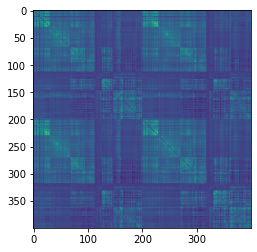

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


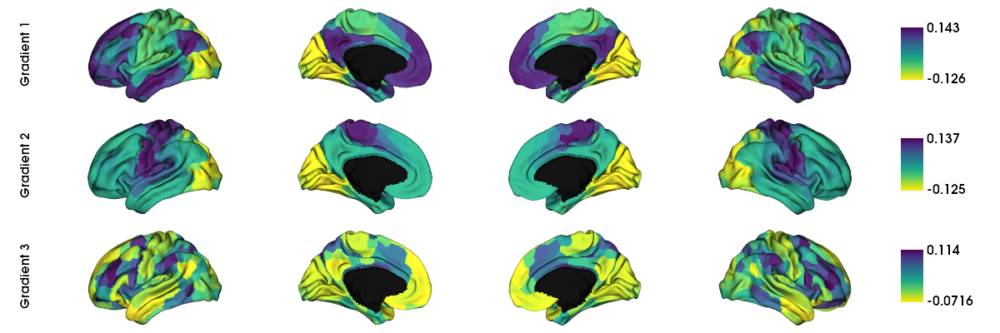

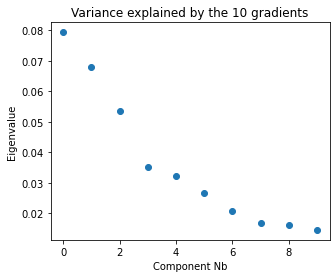

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.36

Scaled variance explained by individual gradients:
G1: 21.85%
G2: 18.71%
G3: 14.72%



In [45]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all subjects)
mean_fc_matrix = sum(fc_matrices)/len(fc_matrices)

# compute mean gradients
mean_fc_grad = compute_mean_gradients(mean_conn_matrix = mean_fc_matrix, display_output = True, data_reduction_algorithm = 'dm', save_screenshot = False, sample_modality = 'HCP_fc')

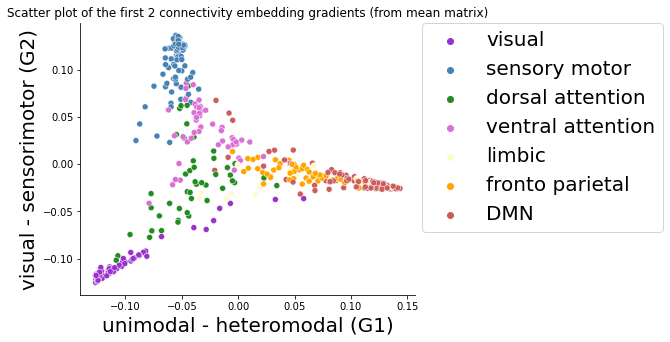

In [46]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_fc_grad.gradients_[:,0],  # all rows (400 parces), first column (G1: unimodal - heteromodal)
                     y=mean_fc_grad.gradients_[:,1],  # all rows (400 parces), second column (G2: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G1)', fontsize = 20);
ax.set_ylabel('visual - sensorimotor (G2)', fontsize = 20);
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')

ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc=2, borderaxespad=0)
#ax.legend(loc=2, prop={'size': 6})

plt.show(ax)

## Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [47]:
compute_aligned_grad = compute_aligned_gradients(fc_matrices, mean_fc_grad.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1 = compute_aligned_grad['array_aligned_G1']
array_aligned_fc_G2 = compute_aligned_grad['array_aligned_G2']
array_aligned_fc_G3 = compute_aligned_grad['array_aligned_G3']

### Exporting Gradients to csv for R analyses

In [48]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir_hcp+'array_aligned_fc_G1.csv', array_aligned_fc_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'array_aligned_fc_G2.csv', array_aligned_fc_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'array_aligned_fc_G3.csv', array_aligned_fc_G3, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

## Mean gradients by sex

*Needed for computing variability & for plotting (mean) Males vs (mean) Females if plan to replicate figure from Hong et al https://www.nature.com/articles/s41467-019-08944-1/figures/3*


In [49]:
# creating lists containing only male and only female fc matrices

fc_matrices_M = []
fc_matrices_F = []

for i in range(len(fc_matrices)):
    if HCP_demographics_cleaned_final.Gender.iloc[i] == "M":
        fc_matrices_M.append(fc_matrices[i])
    elif HCP_demographics_cleaned_final.Gender.iloc[i] == "F":
        fc_matrices_F.append(fc_matrices[i])

### Males

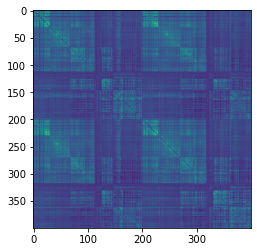

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


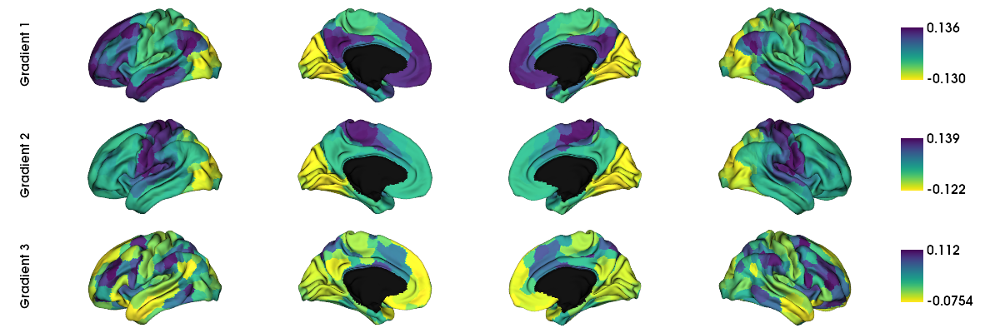

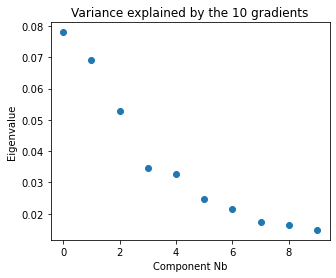

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.36

Scaled variance explained by individual gradients:
G1: 21.52%
G2: 19.09%
G3: 14.61%



In [50]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all males)
mean_fc_matrix_M = sum(fc_matrices_M)/len(fc_matrices_M)

# compute mean gradients
mean_fc_grad_M = compute_mean_gradients(mean_conn_matrix = mean_fc_matrix_M, display_output = True, data_reduction_algorithm = 'dm', save_screenshot = False, sample_modality = 'HCP_fc_M')

### Females

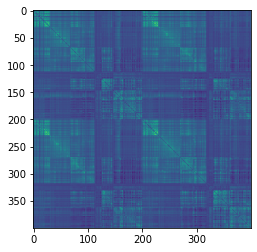

(400, 400)


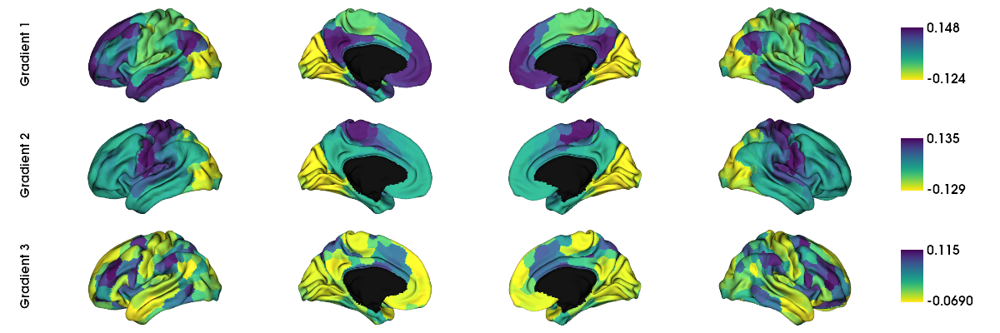

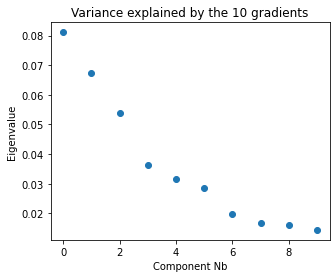

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.37

Scaled variance explained by individual gradients:
G1: 22.23%
G2: 18.42%
G3: 14.72%



In [51]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all females)
mean_fc_matrix_F = sum(fc_matrices_F)/len(fc_matrices_F)

# compute mean gradients
mean_fc_grad_F = compute_mean_gradients(mean_conn_matrix = mean_fc_matrix_F, display_output = True, data_reduction_algorithm = 'dm', save_screenshot = False, sample_modality = 'HCP_fc_F')

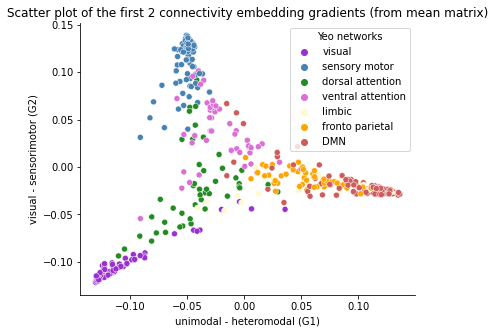

In [52]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_fc_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1: unimodal - heteromodal)
                     y=mean_fc_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G1)');
ax.set_ylabel('visual - sensorimotor (G2)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

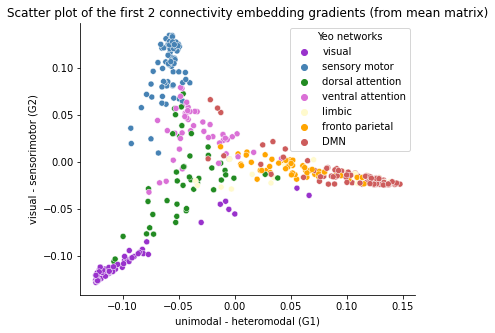

In [53]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_fc_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1: unimodal - heteromodal)
                     y=mean_fc_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G1)');
ax.set_ylabel('visual - sensorimotor (G2)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

### Males vs Females

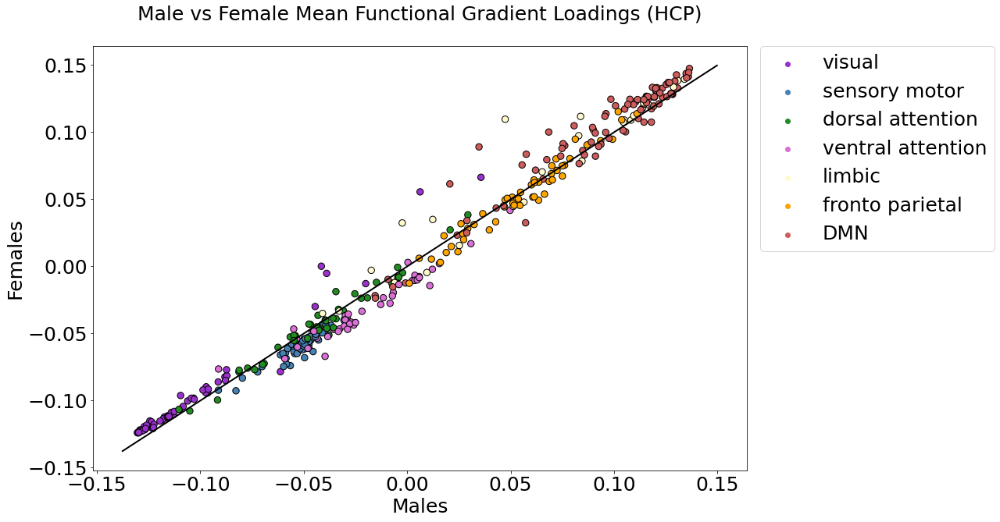

In [54]:
# plotting HCP G2 mean loadings
plot_mean_parcel_values_scatter_bysex(male_data = mean_fc_grad_M.gradients_[:,0], female_data = mean_fc_grad_F.gradients_[:,0], title = 'Mean Functional Gradient Loadings (HCP)')

## Aligned gradients by sex 
*Needed to compute variability within sexes and to test brain size effects on FC G1 within sex*

In [52]:
### Males

compute_aligned_grad_M = compute_aligned_gradients(fc_matrices_M, mean_fc_grad_M.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1_M = compute_aligned_grad_M['array_aligned_G1']
array_aligned_fc_G2_M = compute_aligned_grad_M['array_aligned_G2']
array_aligned_fc_G3_M = compute_aligned_grad_M['array_aligned_G3']


### Females

compute_aligned_grad_F = compute_aligned_gradients(fc_matrices_F, mean_fc_grad_F.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_fc_G1_F = compute_aligned_grad_F['array_aligned_G1']
array_aligned_fc_G2_F = compute_aligned_grad_F['array_aligned_G2']
array_aligned_fc_G3_F = compute_aligned_grad_F['array_aligned_G3']

#### Exporting arrays by sex to csv for R analyses (ICV contrast on FC G1 within sex)

In [149]:
# geodesic distance matrices 

np.savetxt(resdir_hcp+'array_aligned_fc_G1_M.csv', array_aligned_fc_G1_M, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'array_aligned_fc_G1_F.csv', array_aligned_fc_G1_F, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

# Variability (individual- and sex-level) in functional gradient loadings

## 1. Whole brain level: Correlating individual subject gradient loadings with HCP mean gradient loadings (to see deviations from the mean)

### Unimodal-heteromodal gradient

Compared to 0.3-0.9 range of correlation coefficients when comparing individual level GSP gradient loading with mean HCP

Correlation of individual gradient loadings to mean gradient loadings (age ordered)


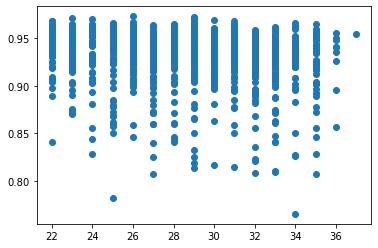

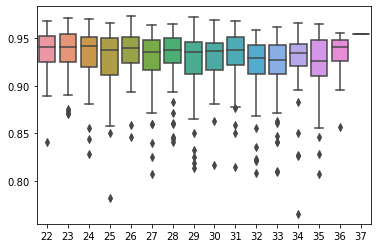

Correlation of individual gradient loadings to mean gradient loadings of given sex (color-coded by sex)


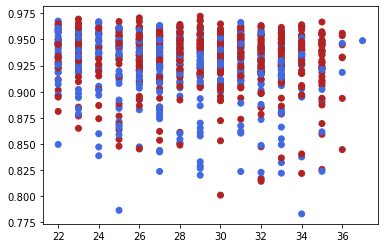

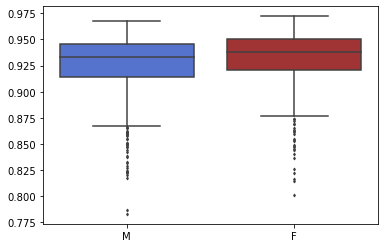

Mean correlation coefficient of male individual gradients and mean male gradient: M = 0.92; SD = 0.032
Mean correlation coefficient of female individual gradients and mean female gradient: M = 0.93; SD = 0.027



In [63]:
variability_wholebrain_corr_to_mean(mean_grad = mean_fc_grad.gradients_[:,0], mean_grad_M = mean_fc_grad_M.gradients_[:,0], mean_grad_F = mean_fc_grad_F.gradients_[:,0], subject_grad = array_aligned_fc_G1, subject_ages =  HCP_demographics_cleaned_final.Age_in_Yrs.tolist(), subject_sexes = HCP_demographics_cleaned_final.Gender.tolist())

### Visual-sensorimotor gradient

#### Comparing individual gradients to overall mean (ordered by age)

To study variability as a function of age

Correlation of individual gradient loadings to mean gradient loadings (age ordered)


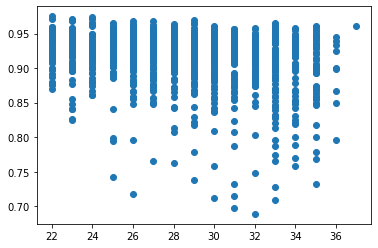

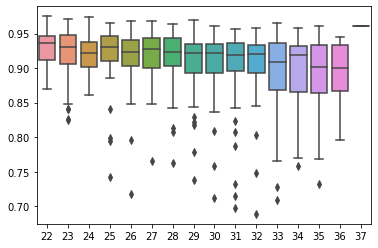

Correlation of individual gradient loadings to mean gradient loadings of given sex (color-coded by sex)


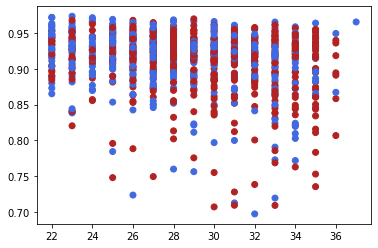

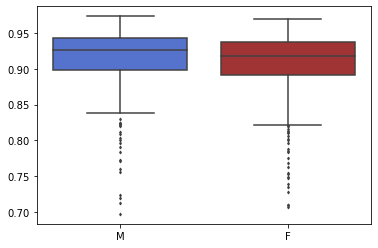

Mean correlation coefficient of male individual gradients and mean male gradient: M = 0.92; SD = 0.041
Mean correlation coefficient of female individual gradients and mean female gradient: M = 0.91; SD = 0.044



In [68]:
variability_wholebrain_corr_to_mean(mean_grad = mean_fc_grad.gradients_[:,1], mean_grad_M = mean_fc_grad_M.gradients_[:,1], mean_grad_F = mean_fc_grad_F.gradients_[:,1], subject_grad = array_aligned_fc_G2, subject_ages =  HCP_demographics_cleaned_final.Age_in_Yrs.tolist(), subject_sexes = HCP_demographics_cleaned_final.Gender.tolist())

## 2. Parcel level: Visualizing standard deviation by parcels in both sexes separately

To visualize which sex and parcels have most variability

Number of parcels for which there males have a statistically significant larger variance than females: 26
Number of parcels for which there females have a statistically significant larger variance than males: 53
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 5
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 15

Minimum SD: Males = 0.013; Females = 0.014
Maximum SD: Males = 0.065; Females = 0.069


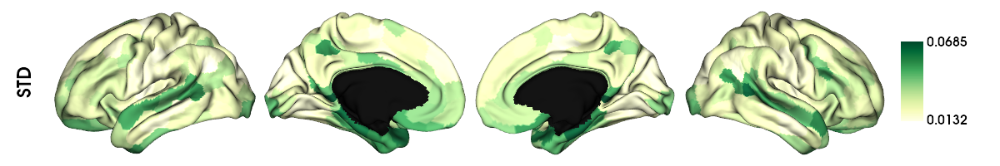

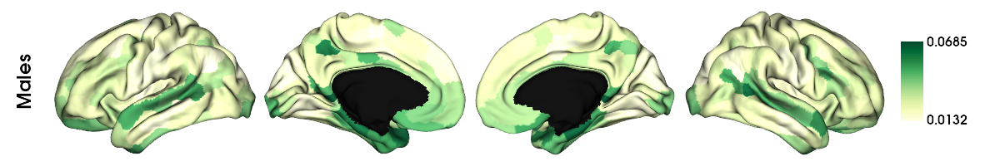

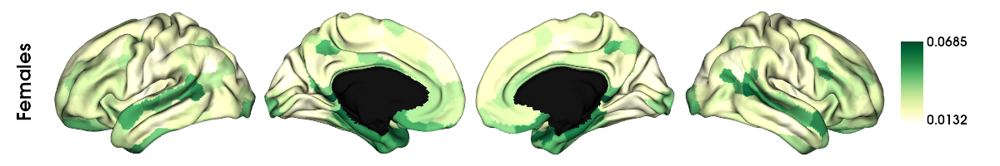

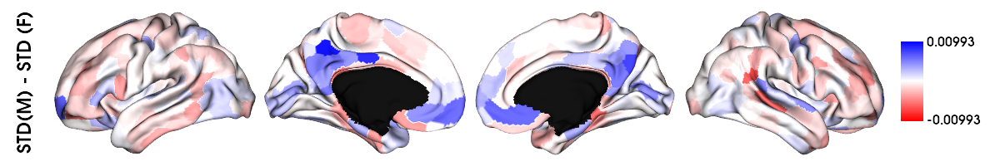

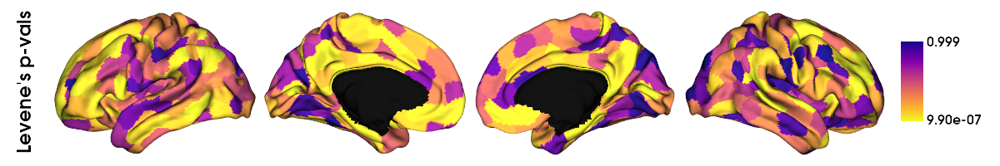

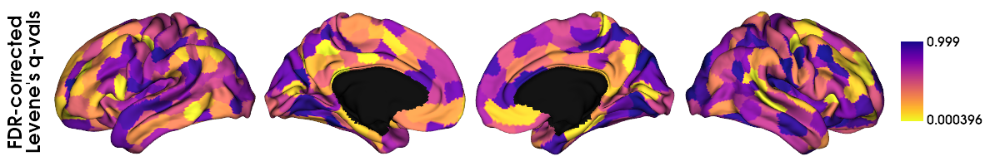

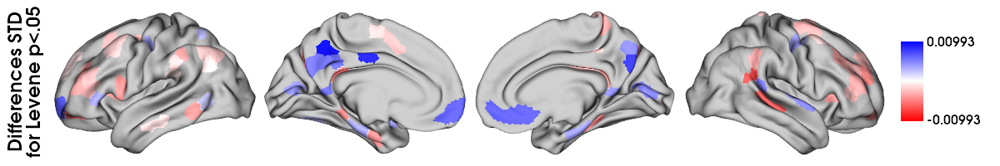

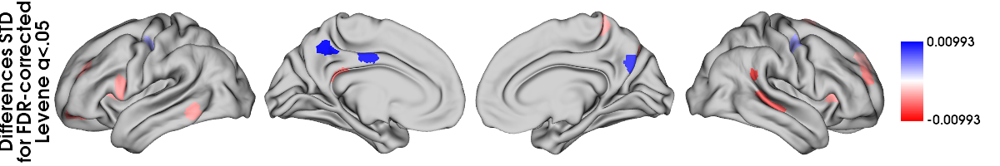

Number of significant parcels: 20

Number of significant parcels for males: 5
Number of significant parcels for females: 15

Number of significant parcels in each Yeo network (across sexes):
- visual: 0 out of 61 (0.0%) -> 0.0% of overall significance
- sensory motor: 3 out of 77 (3.9%) -> 15.0% of overall significance
- DMN: 7 out of 90 (7.78%) -> 35.0% of overall significance
- dorsal attention: 0 out of 46 (0.0%) -> 0.0% of overall significance
- ventral attention: 6 out of 47 (12.77%) -> 30.0% of overall significance
- limbic: 0 out of 26 (0.0%) -> 0.0% of overall significance
- fronto parietal: 4 out of 53 (7.55%) -> 20.0% of overall significance





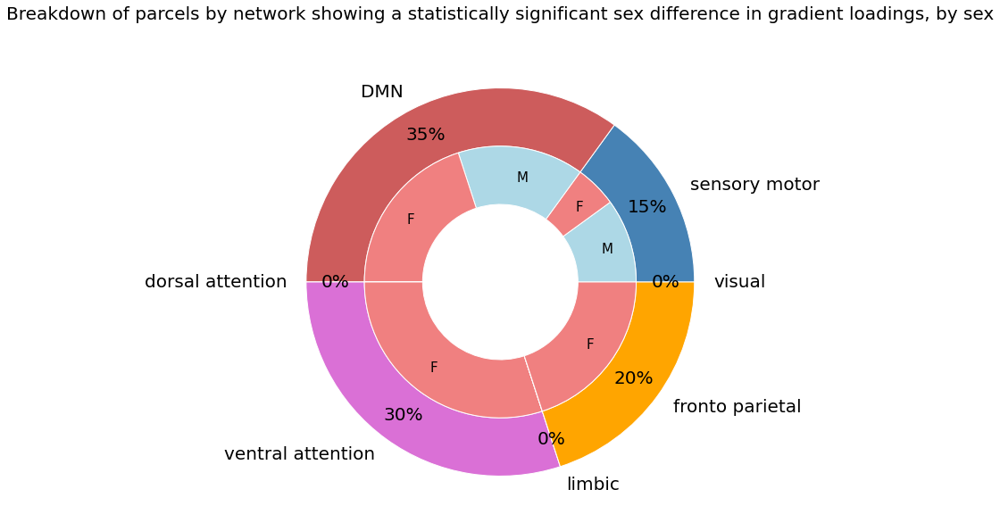

Number of significant parcels by sex:
visual - Male: 0, Female: 0
sensory motor - Male: 2, Female: 1
DMN - Male: 3, Female: 4
dorsal attention - Male: 0, Female: 0
ventral attention - Male: 0, Female: 6
limbic - Male: 0, Female: 0
fronto parietal - Male: 0, Female: 4





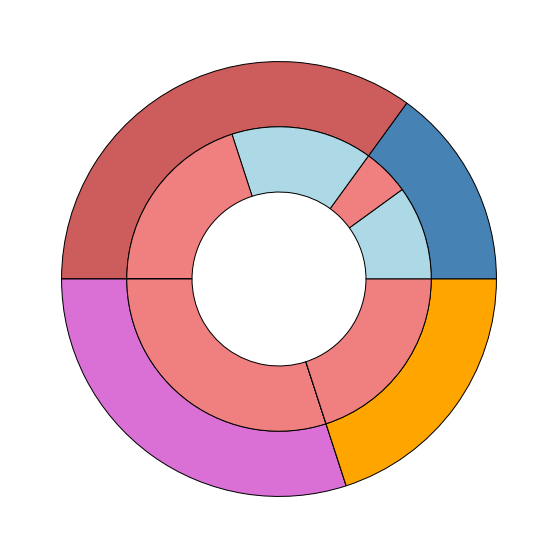

In [87]:
variability_parcel_std(subject_grad = array_aligned_fc_G1, subject_grad_M = array_aligned_fc_G1_M, subject_grad_F = array_aligned_fc_G1_F, save_plots = False, sample_modality = 'HCP_fc_G1')

## 3. Network level

### a) Correlation coefficient -> Correlating individual subject gradient loadings with mean gradient loadings (by sex) 

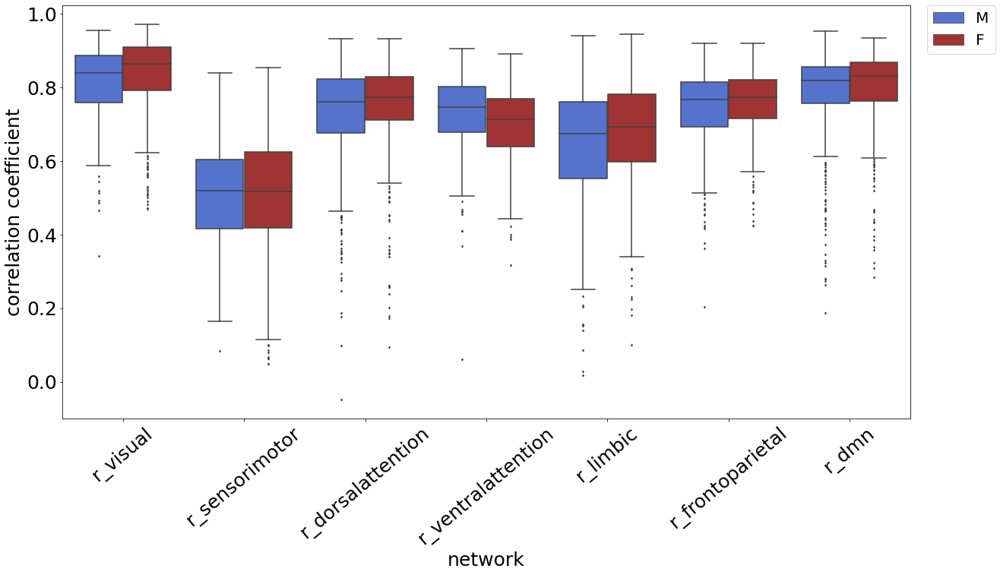

In [70]:
# CAUTION: function is hard-coded for mean G1

variability_network_corr_to_mean_G1(mean_grad = mean_fc_grad.gradients_, mean_grad_M = mean_fc_grad_M.gradients_, mean_grad_F = mean_fc_grad_F.gradients_, subject_grad = array_aligned_fc_G1, subject_grad_M = array_aligned_fc_G1_M, subject_grad_F = array_aligned_fc_G1_F) 

### b) STD -> Mean standard deviation across parcels belonging to same network

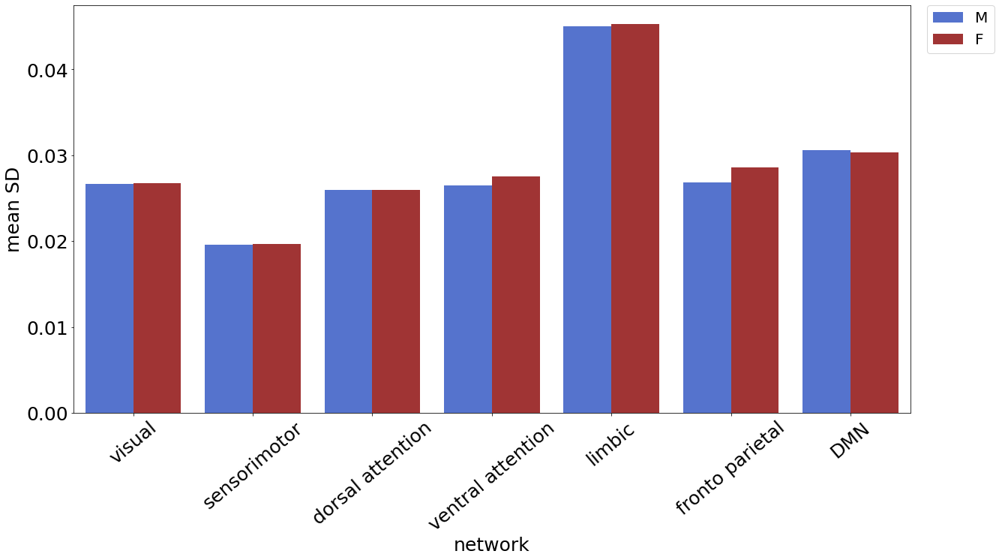

In [71]:
variability_network_std(subject_grad_M = array_aligned_fc_G1_M, subject_grad_F = array_aligned_fc_G1_F)

### c) Parcel level: Visualizing standard deviation by parcels in both sexes separately 
- these are the same values plotted in 2. (by function variability_parcel_std), only masking all but network of interest (spotlight approach)
- color bar standardized across all by taking min and max SD values


Minimum SD: Males = 0.013; Females = 0.014
Maximum SD: Males = 0.065; Females = 0.069


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


Males


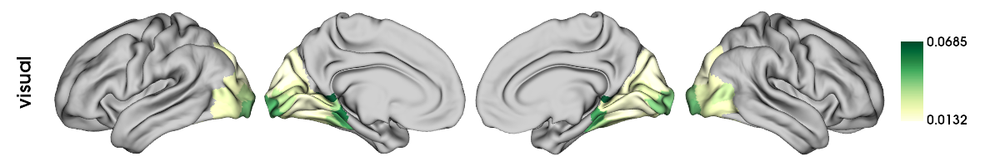

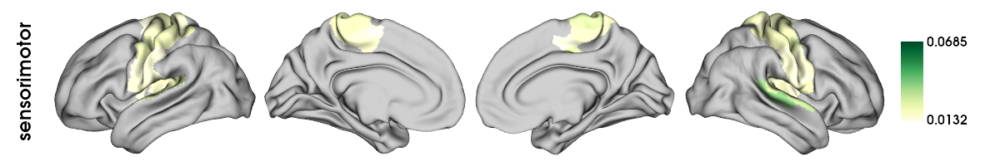

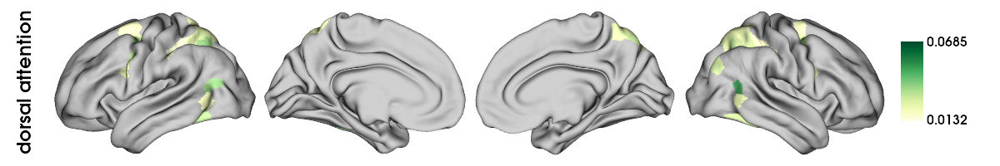

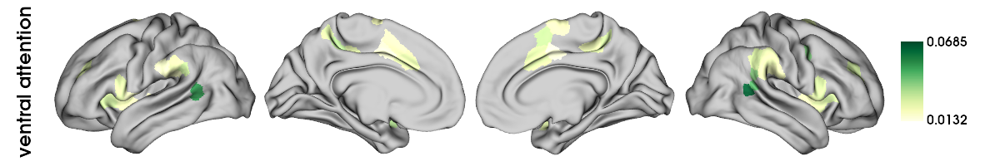

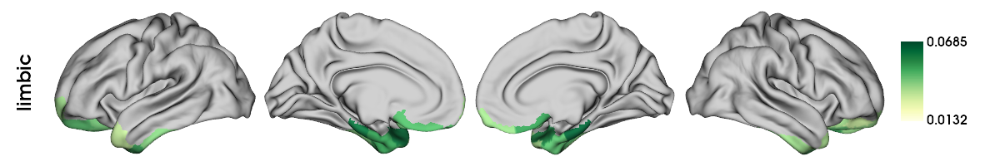

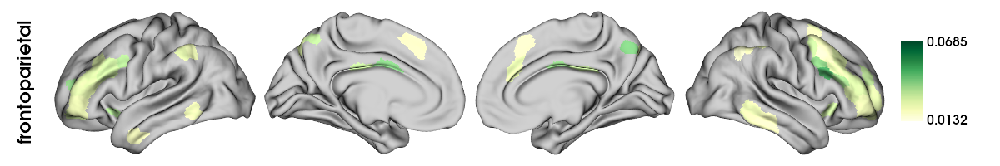

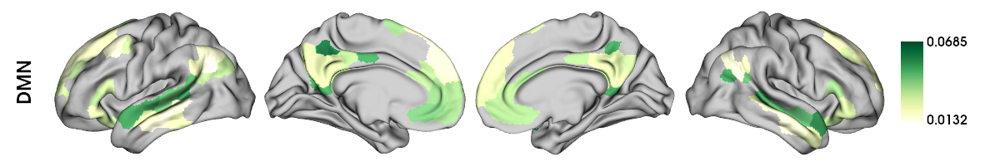

Females


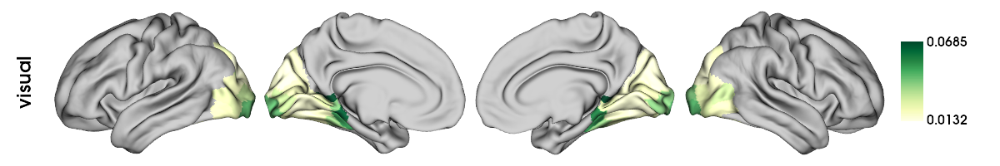

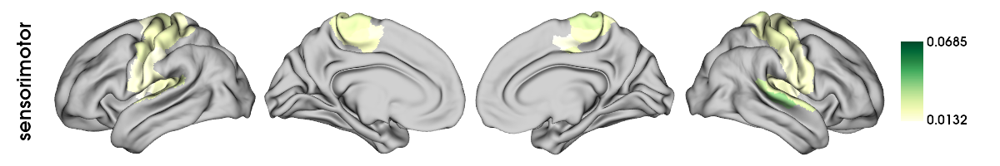

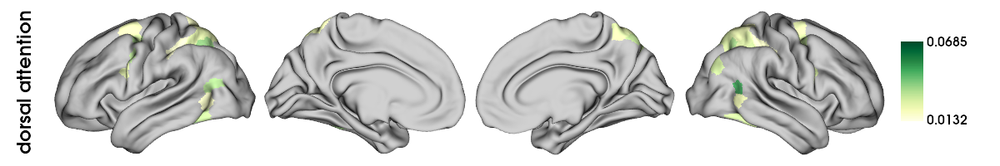

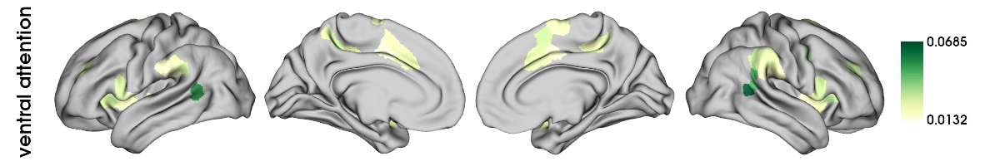

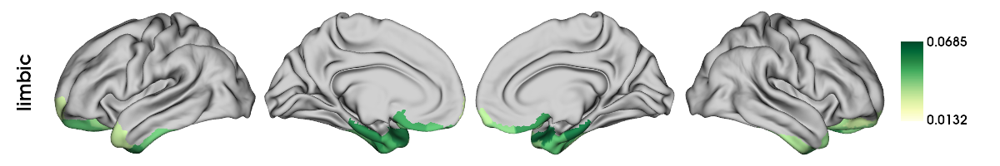

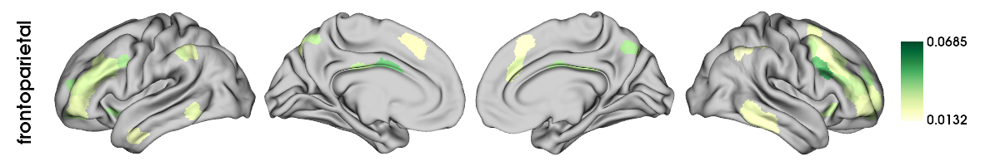

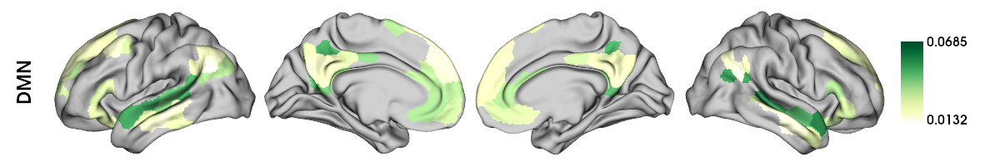

/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:303: RuntimeWarning: All-NaN axis encountered
  a, b = np.nanmin(x), np.nanmax(x)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:367: RuntimeWarning: All-NaN slice encountered
  specs['min'][:] = np.nanmin(specs['min'], axis=ax, keepdims=True)
/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/utils.py:368: RuntimeWarning: All-NaN slice encountered
  specs['max'][:] = np.nanmax(specs['max'], axis=ax, keepdims=True)


difference score (M - F) of STD only for parcels who show statistical inhomogeneity of variance (i.e., Levene's test: p < 0.05)


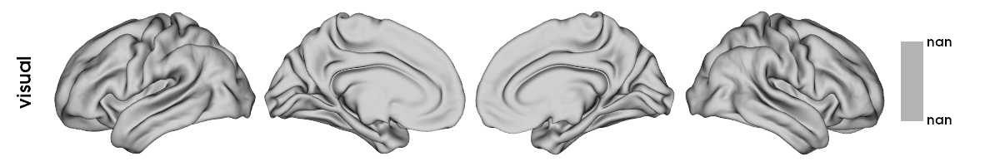

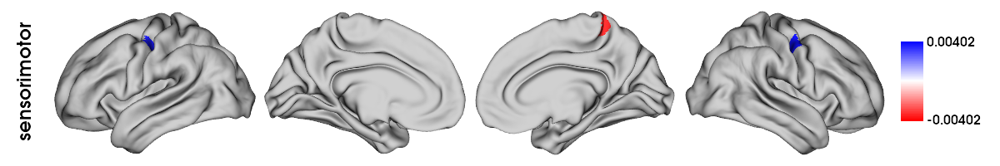

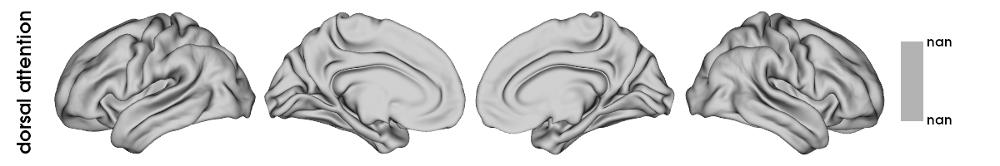

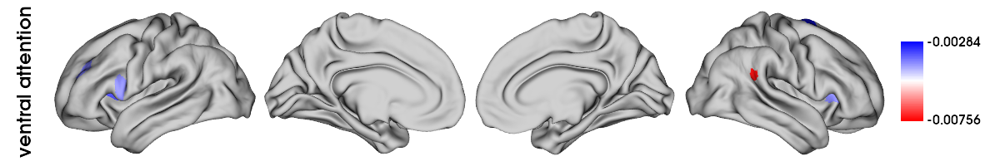

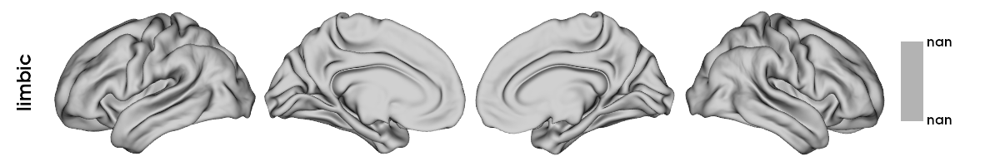

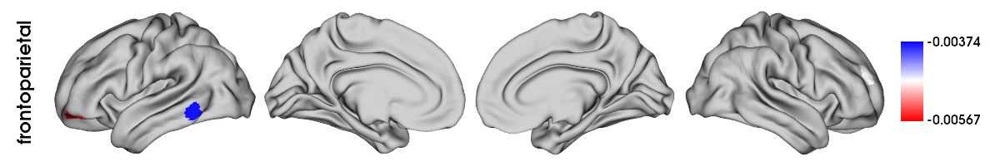

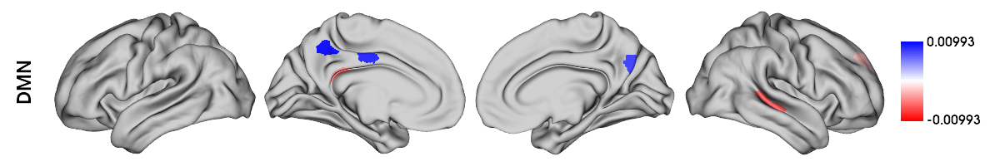

In [72]:
variability_parcel_std_spotlight_network(subject_grad_M = array_aligned_fc_G1_M, subject_grad_F = array_aligned_fc_G1_F)

# Visualizing functional gradients by network (and sex)

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

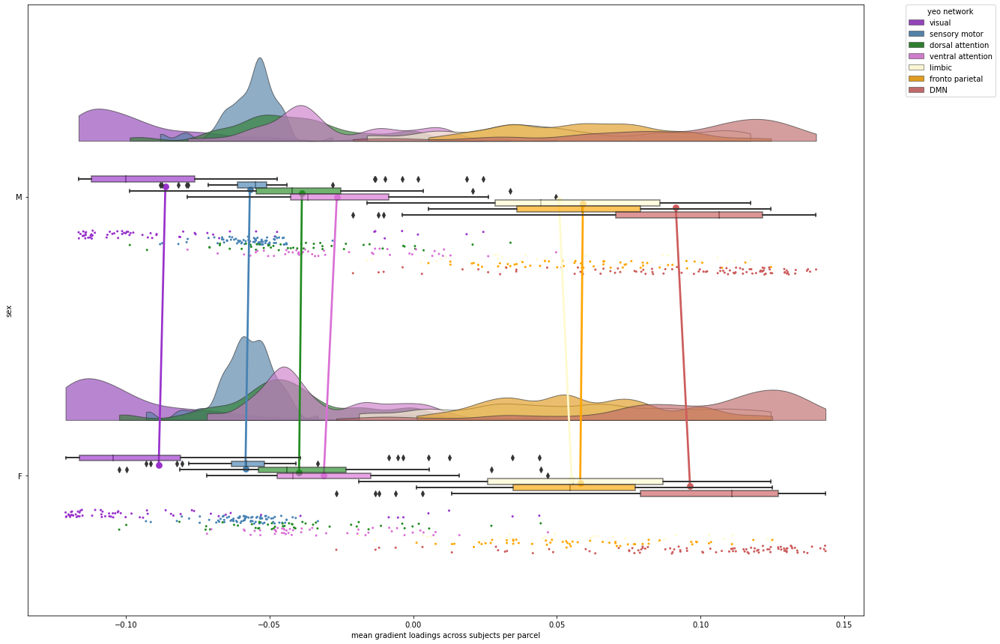

In [56]:
RainCloudPlot_YeoNetworks_SexComparison(array_grad = array_aligned_fc_G1, sex_comp = HCP_demographics_cleaned_final["Gender"])

# Sex effects functional gradients (standard linear regression - FDR-corrected 

In [159]:
# loading R results

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + ICV + random nested effect (family relatedness/twin status) 
R_lmer_fc_G1_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_fc_G1_sex_contrast_res.csv')  
R_lmer_fc_G2_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_fc_G2_sex_contrast_res.csv')  
R_lmer_fc_G3_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_fc_G3_sex_contrast_res.csv')  

## Unimodal - Heteromodal gradient (G1)

Number of significant parcels: 118

Number of significant parcels for males: 70
Number of significant parcels for females: 48

Number of significant parcels in each Yeo network (across sexes):
- visual: 19 out of 61 (31.15%) -> 16.1% of overall significance
- sensory motor: 11 out of 77 (14.29%) -> 9.32% of overall significance
- DMN: 33 out of 90 (36.67%) -> 27.97% of overall significance
- dorsal attention: 5 out of 46 (10.87%) -> 4.24% of overall significance
- ventral attention: 31 out of 47 (65.96%) -> 26.27% of overall significance
- limbic: 4 out of 26 (15.38%) -> 3.39% of overall significance
- fronto parietal: 15 out of 53 (28.3%) -> 12.71% of overall significance





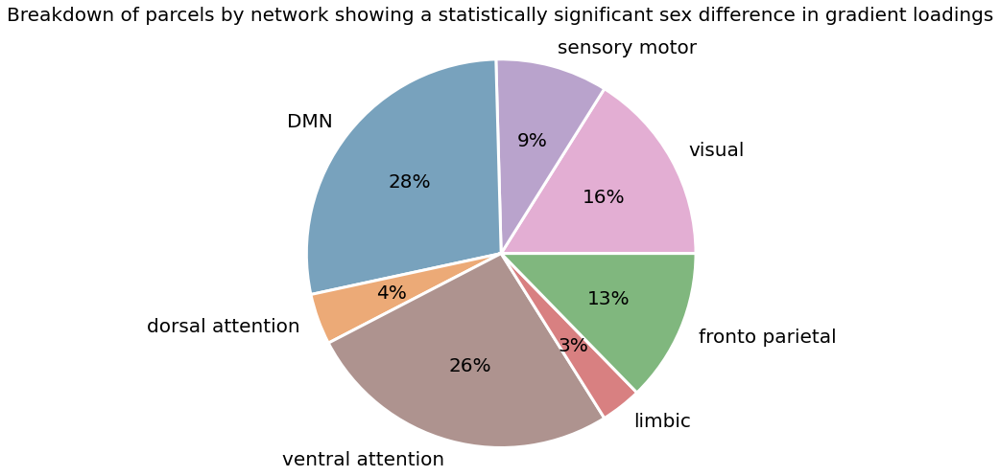

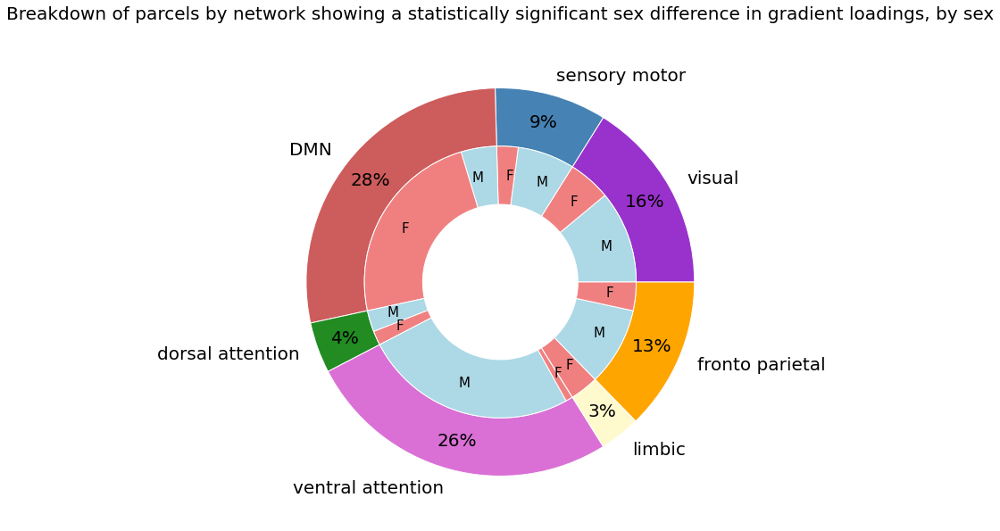

Number of significant parcels by sex:
visual - Male: 13, Female: 6
sensory motor - Male: 8, Female: 3
DMN - Male: 5, Female: 28
dorsal attention - Male: 3, Female: 2
ventral attention - Male: 30, Female: 1
limbic - Male: 0, Female: 4
fronto parietal - Male: 11, Female: 4





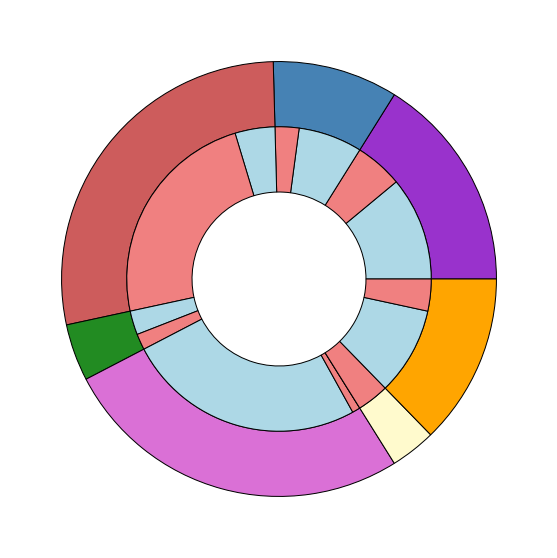




Violin plot of t-values (regression results) by Yeo network


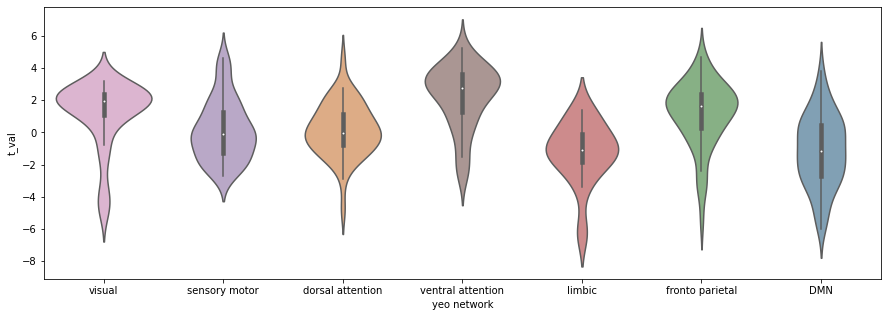

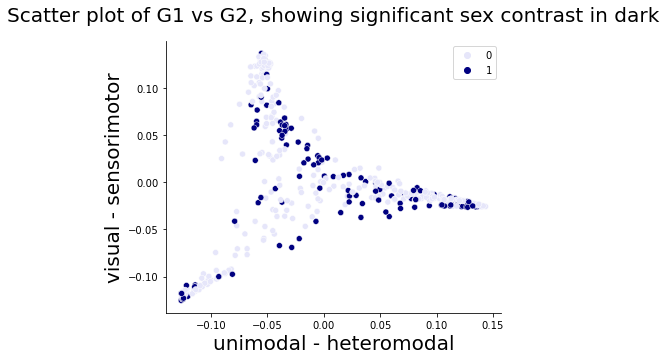

In [160]:
regression_contrast_results_breakdown_by_network(R_lmer_fc_G1_sex_contrast_res, contrast_type = 'sex', 
                                                 scatter_x = mean_fc_grad.gradients_[:,0], scatter_y = mean_fc_grad.gradients_[:,1], 
                                                 scatter_x_label = 'unimodal - heteromodal',  scatter_y_label = 'visual - sensorimotor',
                                                 sample_modality = 'HCP_fc_G1')

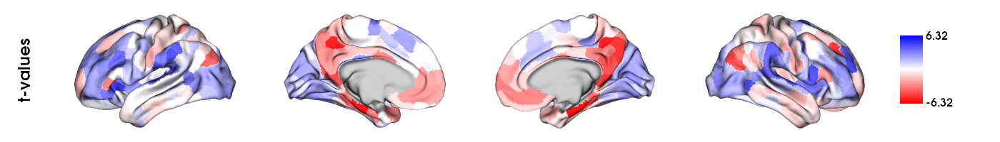

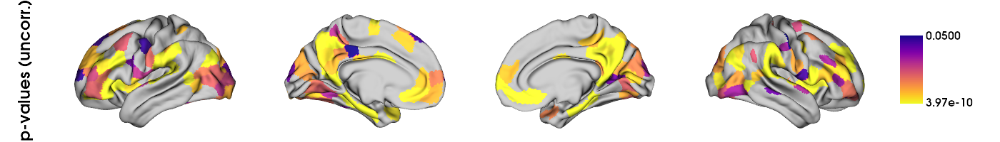

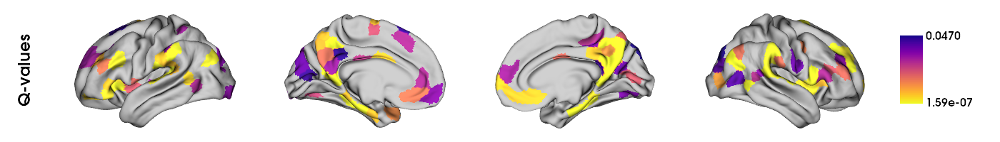

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

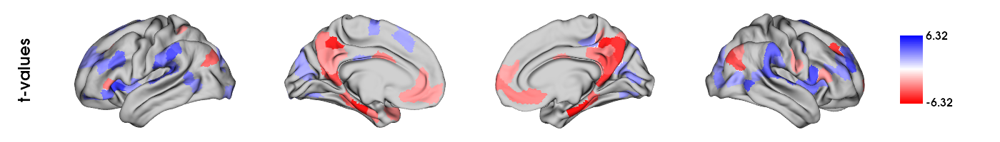

In [163]:
plots_to_display = plot_reg_results_R(R_lmer_fc_G1_sex_contrast_res, contrast_type = 'sex', save_screenshot = False, sample_modality = 'HCP_fc_G1')
display(*plots_to_display)

#
#
#
#
# Computing MPC gradients

## Mean gradients

*Needed for figures and for computing aligned gradients*

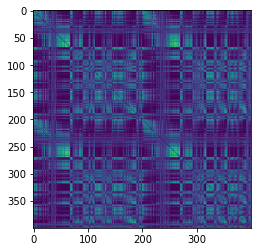

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


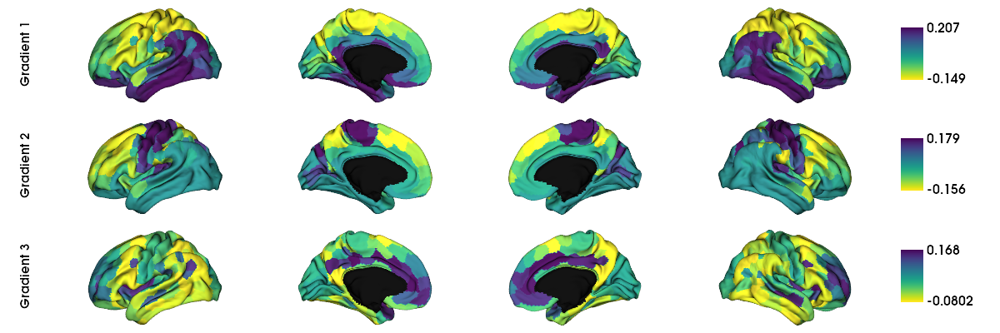

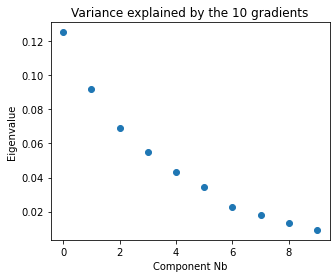

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.48

Scaled variance explained by individual gradients:
G1: 25.97%
G2: 19.07%
G3: 14.37%



In [73]:
# compute the mean MPC matrix (by averaging the connectivity matrices of all subjects)
mean_mpc_matrix = sum(MPC_matrices)/len(MPC_matrices)

# compute mean gradients
mean_mpc_grad = compute_mean_gradients(mean_conn_matrix = mean_mpc_matrix, display_output = True, data_reduction_algorithm = 'dm', save_screenshot = False, sample_modality = 'HCP_mpc')

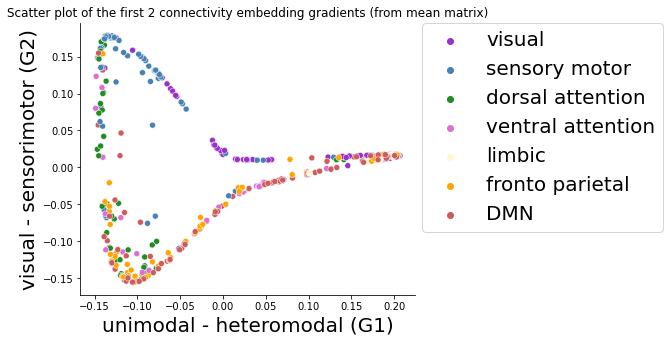

In [74]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_mpc_grad.gradients_[:,0],  # all rows (400 parces), first column (G1: unimodal - heteromodal)
                     y=mean_mpc_grad.gradients_[:,1],  # all rows (400 parces), second column (G2: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G1)', fontsize = 20);
ax.set_ylabel('visual - sensorimotor (G2)', fontsize = 20);
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')

ax.legend(fontsize=20, bbox_to_anchor=(1.02, 1), loc=2, borderaxespad=0)
#ax.legend(loc=2, prop={'size': 6})

plt.show(ax)

### Export mean_mpc_matrix for structure-function analyses

In [75]:
# all subjects
np.savetxt(resdir_hcp+'HCP_mean_mpc_matrix.csv', mean_mpc_matrix, delimiter=",")

## Aligned gradients

Construct gradients for all subjects (procrustes alignment to the overall mean matrix)

In [76]:
compute_aligned_grad = compute_aligned_gradients(MPC_matrices, mean_mpc_grad.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_mpc_G1 = compute_aligned_grad['array_aligned_G1']
array_aligned_mpc_G2 = compute_aligned_grad['array_aligned_G2']
array_aligned_mpc_G3 = compute_aligned_grad['array_aligned_G3']

### Exporting Gradients to csv for R analyses

In [77]:
# fmt = decimals, header = 1 to 400 (without the first and last string letter because it's the [] of the list, comments = empty because otherwise gives a #

np.savetxt(resdir_hcp+'array_aligned_mpc_G1.csv', array_aligned_mpc_G1, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'array_aligned_mpc_G2.csv', array_aligned_mpc_G2, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')
np.savetxt(resdir_hcp+'array_aligned_mpc_G3.csv', array_aligned_mpc_G3, delimiter=',', fmt = '%.16g', header = str(list(range(1,401)))[1:-1], comments = '')

## Mean gradients by sex

*Needed for computing variability & for plotting (mean) Males vs (mean) Females if plan to replicate figure from Hong et al https://www.nature.com/articles/s41467-019-08944-1/figures/3*


In [78]:
# creating lists containing only male and only female mpc matrices

MPC_matrices_M = []
MPC_matrices_F = []

for i in range(len(MPC_matrices)):
    if HCP_demographics_cleaned_final.Gender.iloc[i] == "M":
        MPC_matrices_M.append(MPC_matrices[i])
    elif HCP_demographics_cleaned_final.Gender.iloc[i] == "F":
        MPC_matrices_F.append(MPC_matrices[i])

### Males

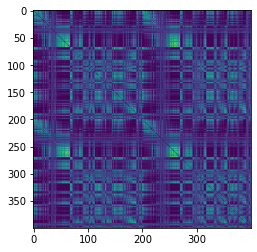

(400, 400)


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


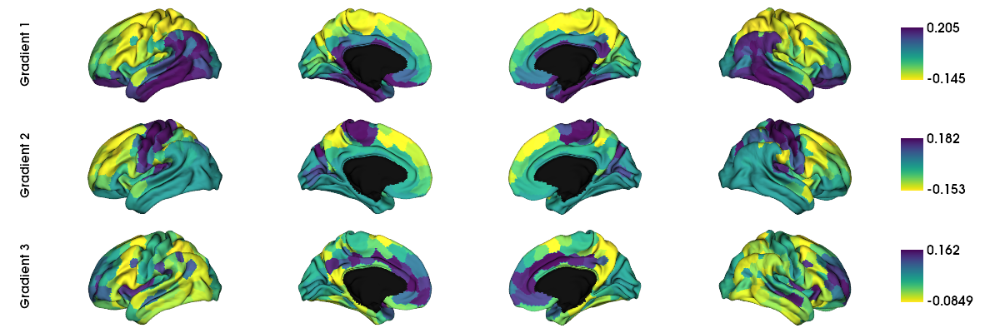

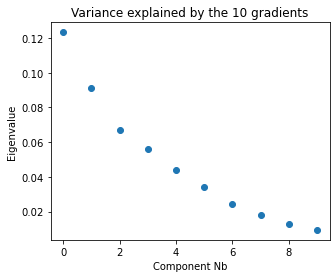

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.48

Scaled variance explained by individual gradients:
G1: 25.74%
G2: 19.01%
G3: 13.96%



In [79]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all males)
mean_mpc_matrix_M = sum(MPC_matrices_M)/len(MPC_matrices_M)

# compute mean gradients
mean_mpc_grad_M = compute_mean_gradients(mean_conn_matrix = mean_mpc_matrix_M, display_output = True, data_reduction_algorithm = 'dm', save_screenshot = False, sample_modality = 'HCP_mpc_M')

### Females

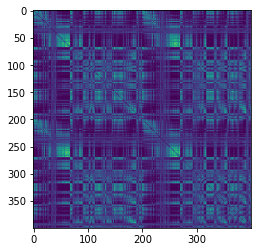

(400, 400)


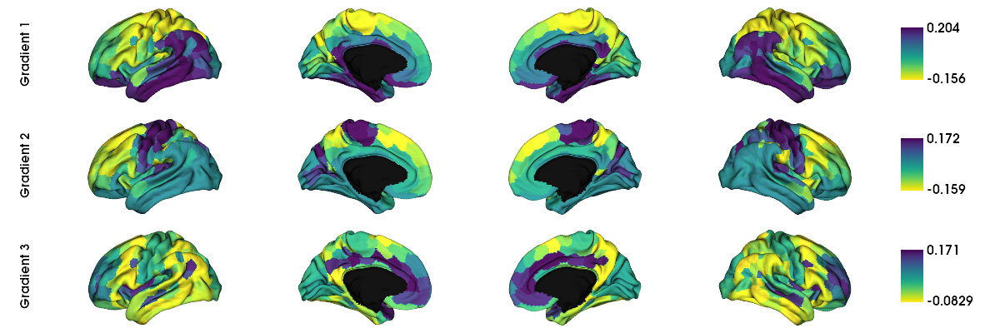

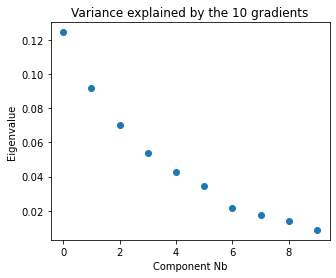

Total amount of variance explained by the 10 gradients (uncorrected sum lambdas): 0.48

Scaled variance explained by individual gradients:
G1: 25.98%
G2: 19.15%
G3: 14.69%



In [80]:
# compute the mean connectivity matrix (by averaging the connectivity matrices of all females)
mean_mpc_matrix_F = sum(MPC_matrices_F)/len(MPC_matrices_F)

# compute mean gradients
mean_mpc_grad_F = compute_mean_gradients(mean_conn_matrix = mean_mpc_matrix_F, display_output = True, data_reduction_algorithm = 'dm', save_screenshot = False, sample_modality = 'HCP_mpc_F')

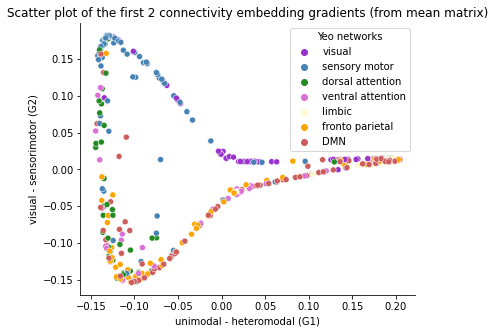

In [81]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_mpc_grad_M.gradients_[:,0],  # all rows (400 parces), first column (G1: unimodal - heteromodal)
                     y=mean_mpc_grad_M.gradients_[:,1],  # all rows (400 parces), second column (G2: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G1)');
ax.set_ylabel('visual - sensorimotor (G2)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

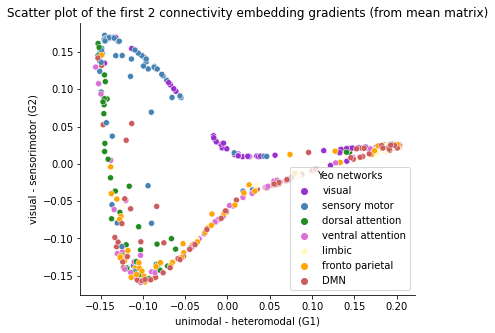

In [82]:
# scatterplot
fig, ax = plt.subplots(figsize=(6,5));
ax = sns.scatterplot(x=mean_mpc_grad_F.gradients_[:,0],  # all rows (400 parces), first column (G1: unimodal - heteromodal)
                     y=mean_mpc_grad_F.gradients_[:,1],  # all rows (400 parces), second column (G2: visual - somatomotor)
                     hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                     palette=palette_labeled_networks,
                     legend=True, ax=ax);

ax.set_xlabel('unimodal - heteromodal (G1)');
ax.set_ylabel('visual - sensorimotor (G2)');
ax.set_title("Scatter plot of the first 2 connectivity embedding gradients (from mean matrix)")
ax.spines['right'].set_visible(False);
ax.spines['top'].set_visible(False);
plt.legend(title='Yeo networks')
plt.show(ax)

### Males vs Females

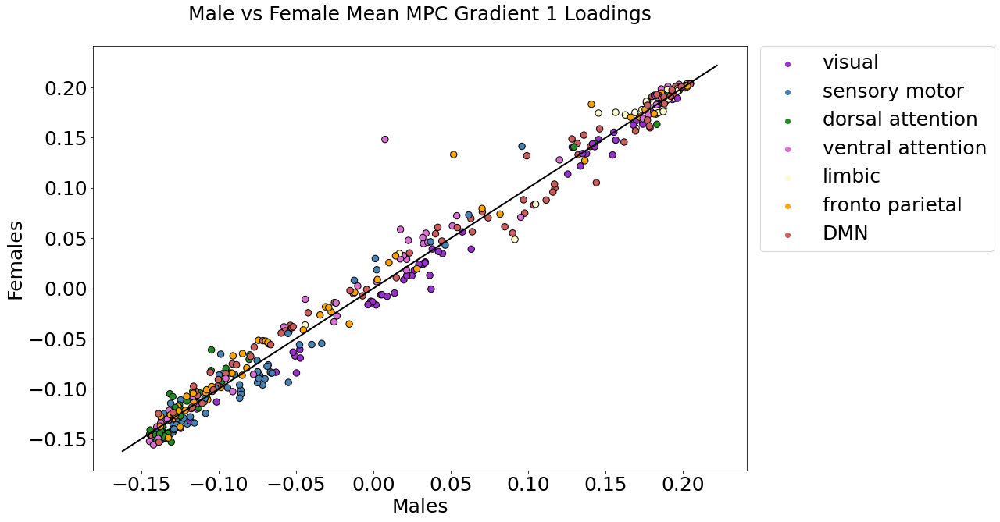

In [83]:
# plotting HCP mean G1 loadings
plot_mean_parcel_values_scatter_bysex(male_data = mean_mpc_grad_M.gradients_[:,0], female_data = mean_mpc_grad_F.gradients_[:,0], title = 'Mean MPC Gradient 1 Loadings')

## Aligned gradients by sex 
*Needed to compute variability within sexes*

In [84]:
### Males

compute_aligned_grad_M = compute_aligned_gradients(MPC_matrices_M, mean_mpc_grad_M.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_mpc_G1_M = compute_aligned_grad_M['array_aligned_G1']
array_aligned_mpc_G2_M = compute_aligned_grad_M['array_aligned_G2']
array_aligned_mpc_G3_M = compute_aligned_grad_M['array_aligned_G3']


### Females

compute_aligned_grad_F = compute_aligned_gradients(MPC_matrices_F, mean_mpc_grad_F.gradients_)

# storing the output of the computation of the aligned gradients
#array_aligned_gradients = compute_aligned_grad['array_aligned_gradients']
array_aligned_mpc_G1_F = compute_aligned_grad_F['array_aligned_G1']
array_aligned_mpc_G2_F = compute_aligned_grad_F['array_aligned_G2']
array_aligned_mpc_G3_F = compute_aligned_grad_F['array_aligned_G3']

# Variability (individual- and sex-level) in gradient values

## 1. Whole brain level: Correlating individual subject gradient loadings with HCP mean gradient loadings (to see deviations from the mean)

Lower correlations that for functional data -> more between subject variability in MPC 

Correlation of individual gradient loadings to mean gradient loadings (age ordered)


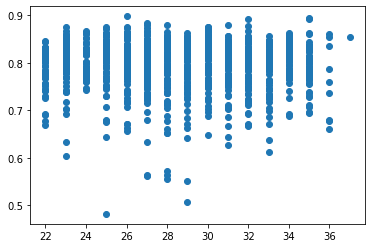

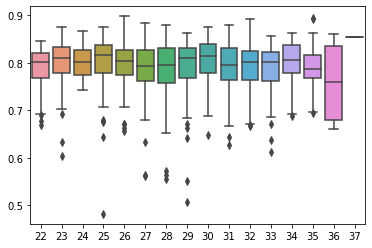

Correlation of individual gradient loadings to mean gradient loadings of given sex (color-coded by sex)


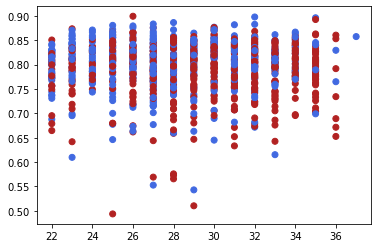

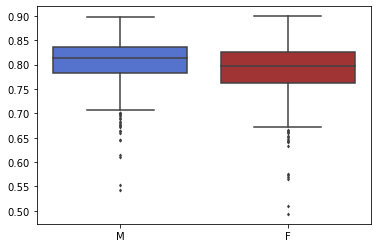

Mean correlation coefficient of male individual gradients and mean male gradient: M = 0.8; SD = 0.05
Mean correlation coefficient of female individual gradients and mean female gradient: M = 0.79; SD = 0.055



In [102]:
variability_wholebrain_corr_to_mean(mean_grad = mean_mpc_grad.gradients_[:,0], mean_grad_M = mean_mpc_grad_M.gradients_[:,0], mean_grad_F = mean_mpc_grad_F.gradients_[:,0], subject_grad = array_aligned_mpc_G1, subject_ages =  HCP_demographics_cleaned_final.Age_in_Yrs.tolist(), subject_sexes = HCP_demographics_cleaned_final.Gender.tolist())

## 2. Parcel level: Visualizing standard deviation by parcels in both sexes separately

To visualize which sex and parcels have most variability

Number of parcels for which there males have a statistically significant larger variance than females: 46
Number of parcels for which there females have a statistically significant larger variance than males: 101
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 32
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 64

Minimum SD: Males = 0.008; Females = 0.009
Maximum SD: Males = 0.076; Females = 0.077


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


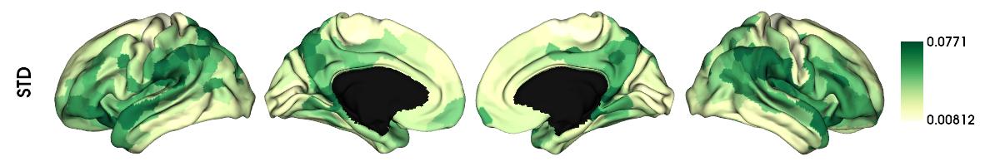

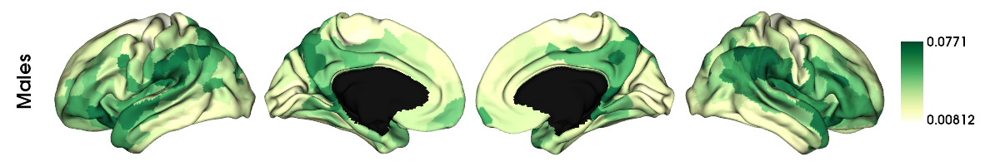

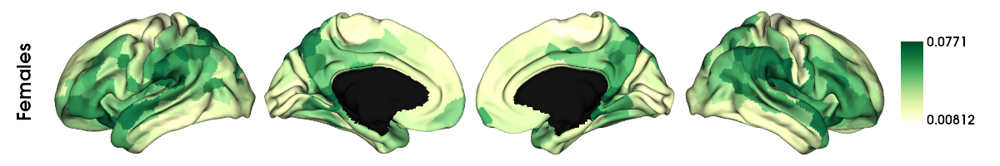

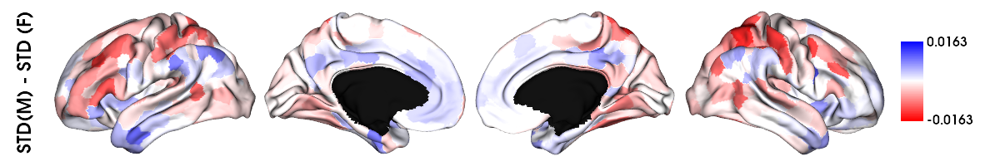

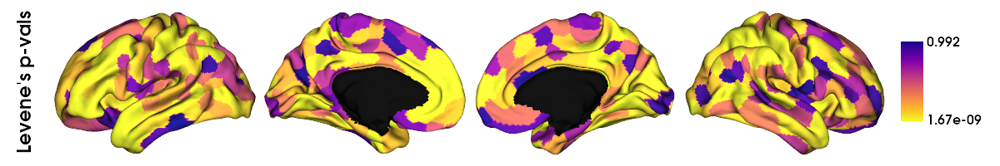

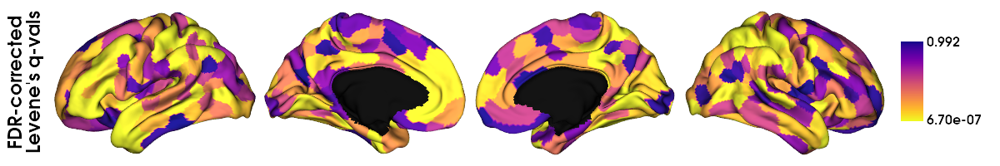

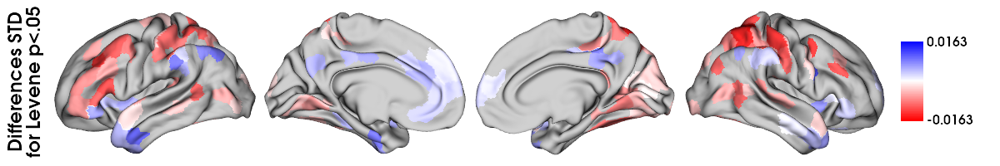

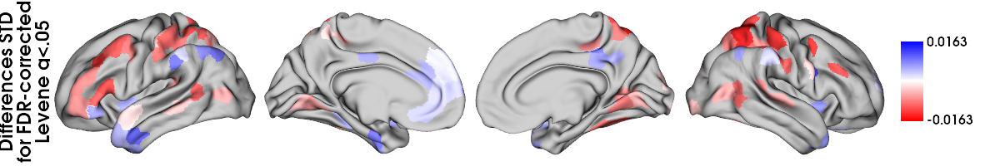

Number of significant parcels: 96

Number of significant parcels for males: 32
Number of significant parcels for females: 64

Number of significant parcels in each Yeo network (across sexes):
- visual: 12 out of 61 (19.67%) -> 12.5% of overall significance
- sensory motor: 15 out of 77 (19.48%) -> 15.62% of overall significance
- DMN: 18 out of 90 (20.0%) -> 18.75% of overall significance
- dorsal attention: 23 out of 46 (50.0%) -> 23.96% of overall significance
- ventral attention: 11 out of 47 (23.4%) -> 11.46% of overall significance
- limbic: 5 out of 26 (19.23%) -> 5.21% of overall significance
- fronto parietal: 12 out of 53 (22.64%) -> 12.5% of overall significance





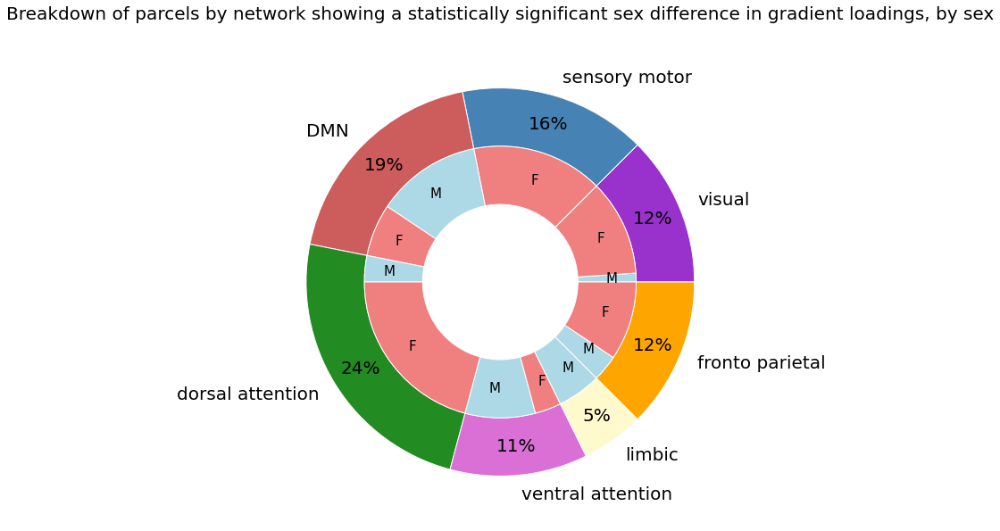

Number of significant parcels by sex:
visual - Male: 1, Female: 11
sensory motor - Male: 0, Female: 15
DMN - Male: 12, Female: 6
dorsal attention - Male: 3, Female: 20
ventral attention - Male: 8, Female: 3
limbic - Male: 5, Female: 0
fronto parietal - Male: 3, Female: 9





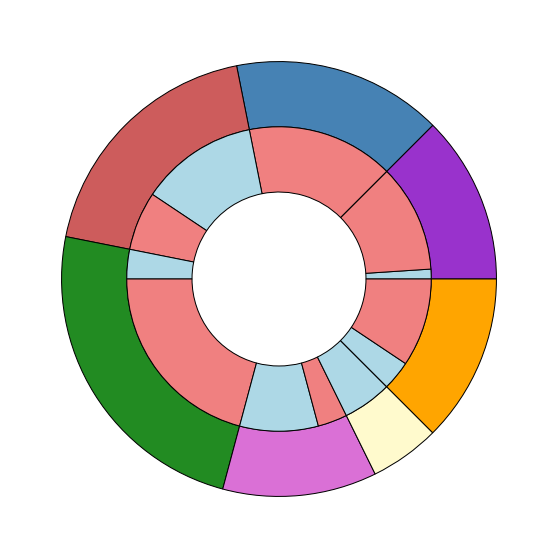

In [103]:
variability_parcel_std(subject_grad = array_aligned_mpc_G1, subject_grad_M = array_aligned_mpc_G1_M, subject_grad_F = array_aligned_mpc_G1_F, save_plots = False, sample_modality = 'HCP_mpc_G1')

## 3. Network level

### a) Correlation coefficient -> Correlating individual subject gradient loadings with mean gradient loadings (by sex) 

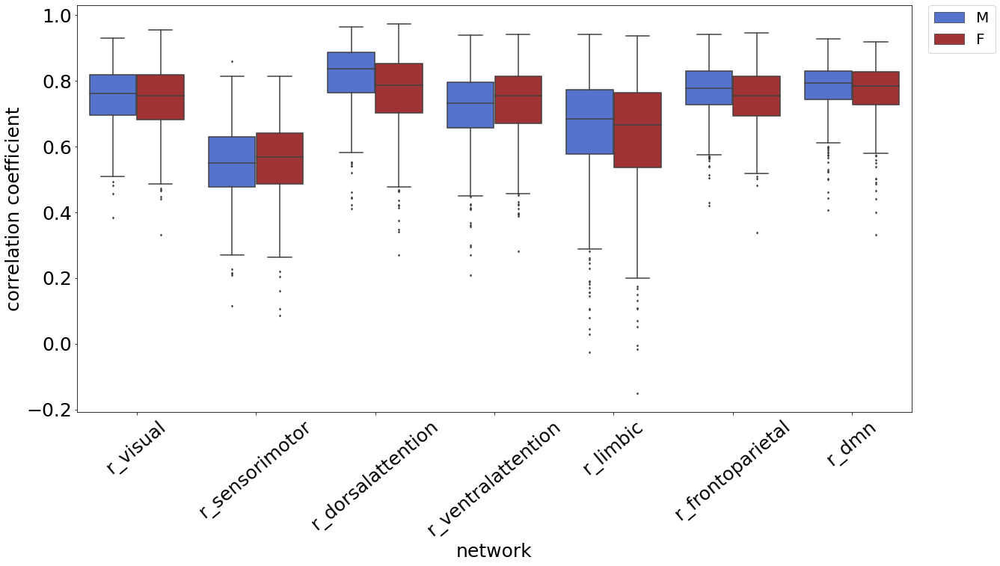

In [104]:
# CAUTION: function is hard-coded for mean G1

variability_network_corr_to_mean_G1(mean_grad = mean_mpc_grad.gradients_, mean_grad_M = mean_mpc_grad_M.gradients_, mean_grad_F = mean_mpc_grad_F.gradients_, subject_grad = array_aligned_mpc_G1, subject_grad_M = array_aligned_mpc_G1_M, subject_grad_F = array_aligned_mpc_G1_F) 

### b) STD -> Mean standard deviation across parcels belonging to same network

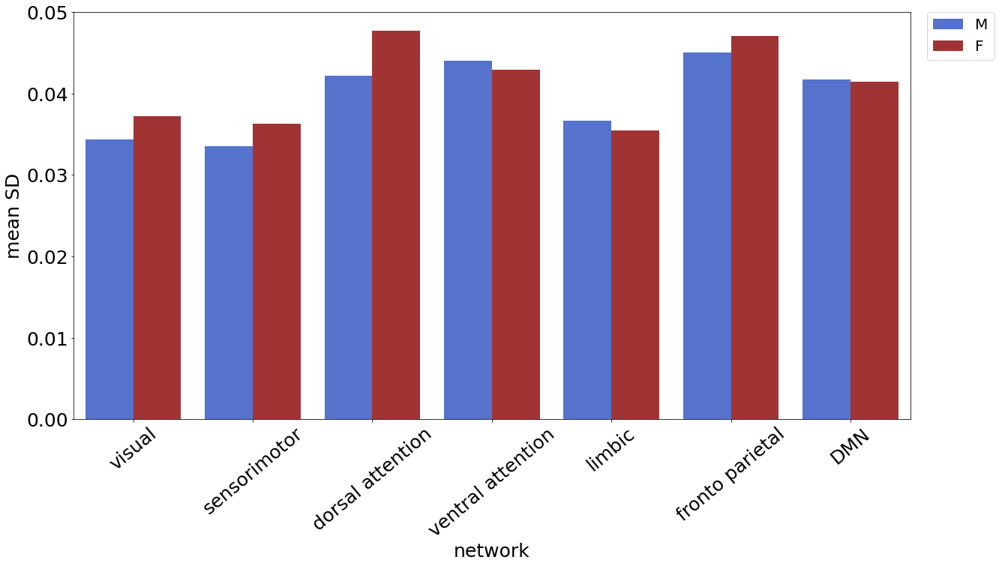

In [105]:
variability_network_std(subject_grad_M = array_aligned_mpc_G1_M, subject_grad_F = array_aligned_mpc_G1_F)

### c) Parcel level: Visualizing standard deviation by parcels in both sexes separately 
- these are the same values plotted in 2. (by function variability_parcel_std), only masking all but network of interest (spotlight approach)
- color bar standardized across all by taking min and max SD values


Minimum SD: Males = 0.008; Females = 0.009
Maximum SD: Males = 0.076; Females = 0.077


/data/u_serio_software/anaconda3/lib/python3.9/site-packages/brainspace/plotting/base.py:287: UserWarning: Interactive mode requires 'panel'. Setting 'interactive=False'
  warnings.warn("Interactive mode requires 'panel'. "


Males


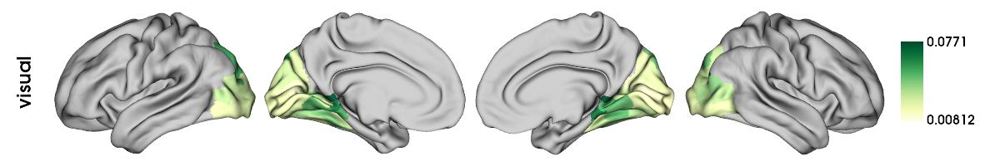

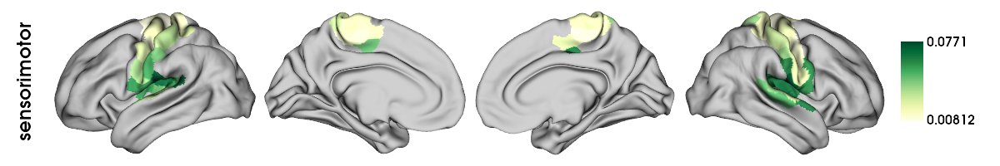

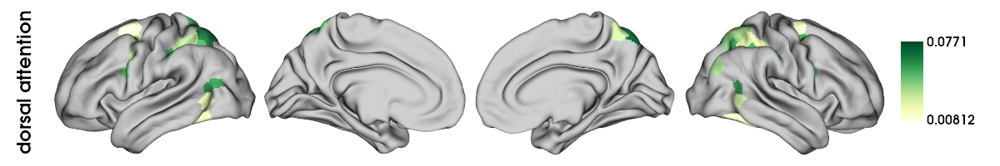

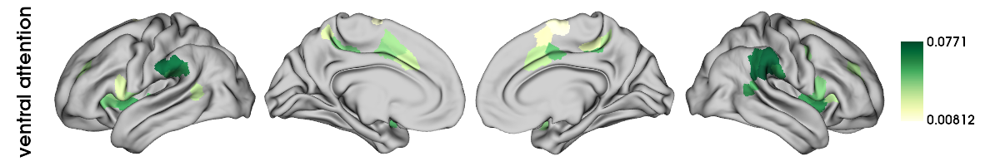

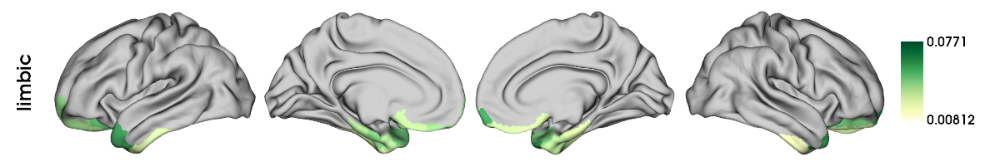

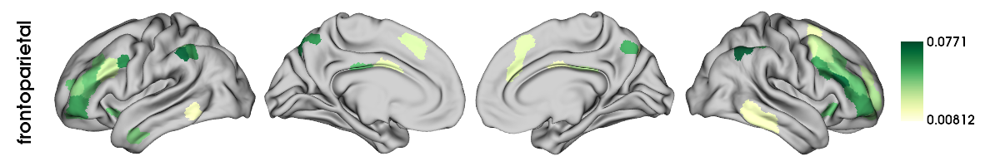

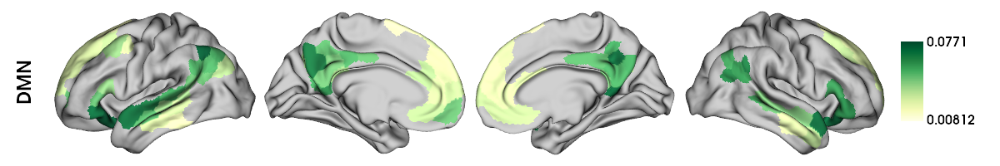

Females


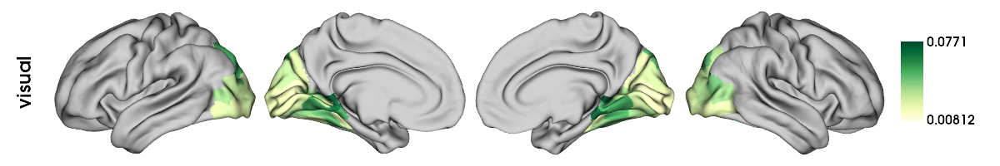

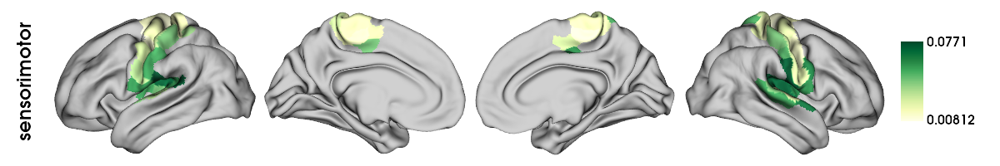

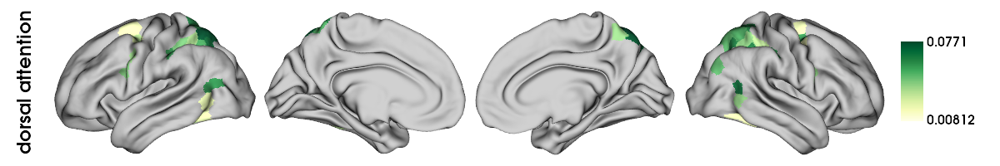

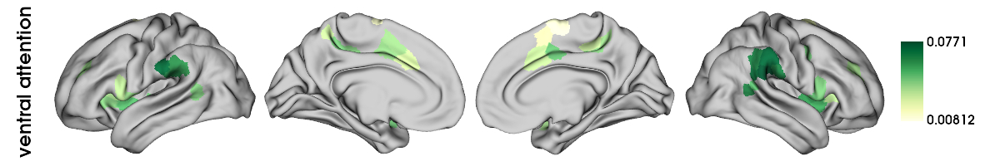

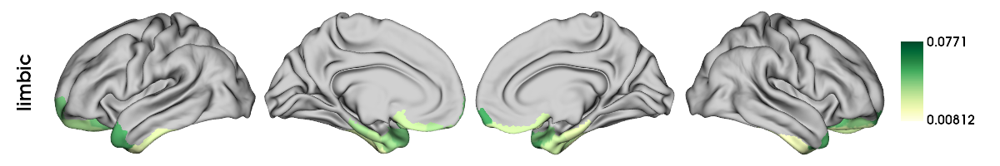

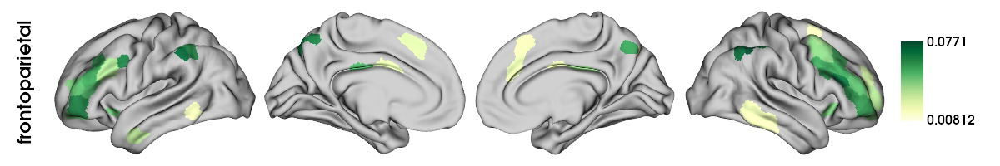

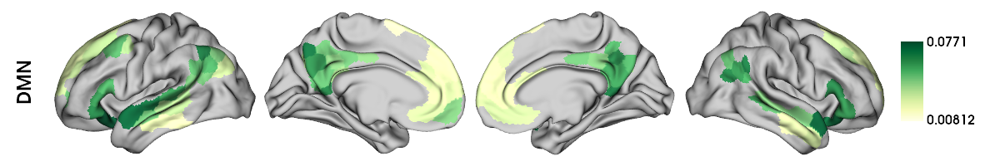

difference score (M - F) of STD only for parcels who show statistical inhomogeneity of variance (i.e., Levene's test: p < 0.05)


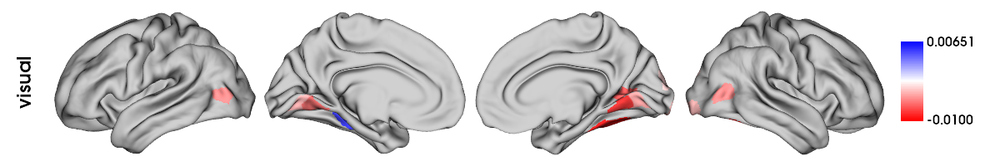

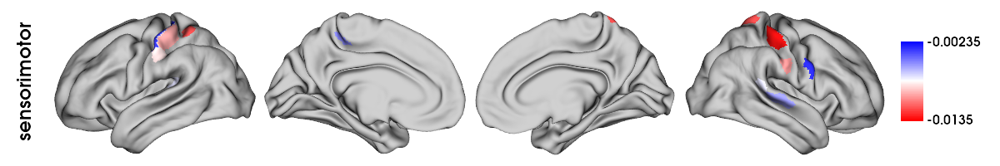

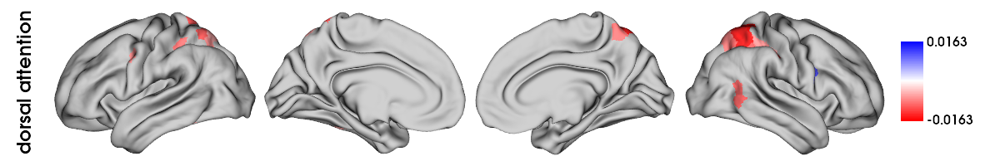

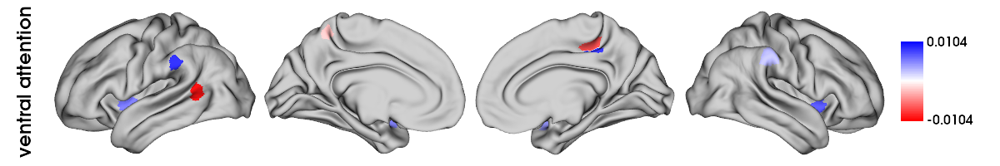

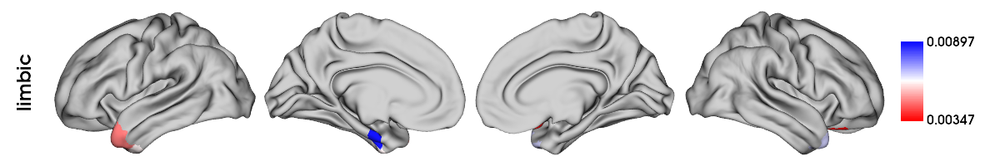

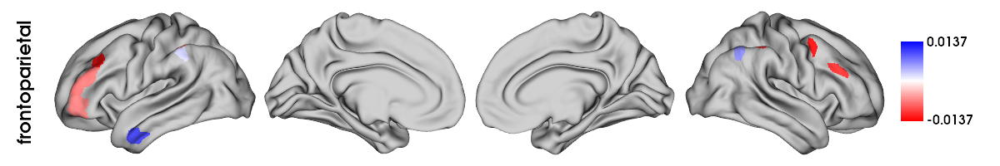

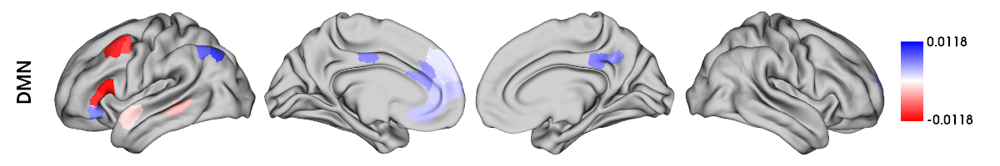

In [106]:
variability_parcel_std_spotlight_network(subject_grad_M = array_aligned_mpc_G1_M, subject_grad_F = array_aligned_mpc_G1_F)

# Visualizing MPC gradients by network (and sex)

Using RainCloud plots https://github.com/RainCloudPlots/RainCloudPlots#python-environment

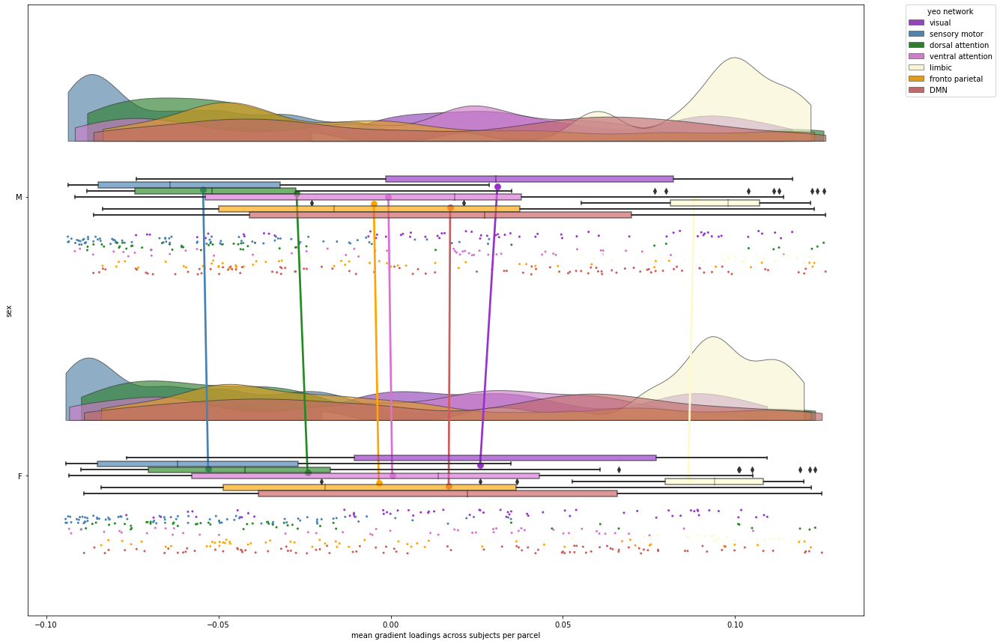

In [107]:
RainCloudPlot_YeoNetworks_SexComparison(array_grad = array_aligned_mpc_G1, sex_comp = HCP_demographics_cleaned_final["Gender"])

# Sex effects MPC gradients (standard linear regression - FDR-corrected

In [165]:
# loading R results

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + ICV + random nested effect (family relatedness/twin status) 
R_lmer_mpc_G1_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_mpc_G1_sex_contrast_res.csv')  
R_lmer_mpc_G2_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_mpc_G2_sex_contrast_res.csv')  
R_lmer_mpc_G3_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_mpc_G3_sex_contrast_res.csv') 

## G1

Number of significant parcels: 43

Number of significant parcels for males: 23
Number of significant parcels for females: 20

Number of significant parcels in each Yeo network (across sexes):
- visual: 11 out of 61 (18.03%) -> 25.58% of overall significance
- sensory motor: 5 out of 77 (6.49%) -> 11.63% of overall significance
- DMN: 7 out of 90 (7.78%) -> 16.28% of overall significance
- dorsal attention: 6 out of 46 (13.04%) -> 13.95% of overall significance
- ventral attention: 7 out of 47 (14.89%) -> 16.28% of overall significance
- limbic: 2 out of 26 (7.69%) -> 4.65% of overall significance
- fronto parietal: 5 out of 53 (9.43%) -> 11.63% of overall significance





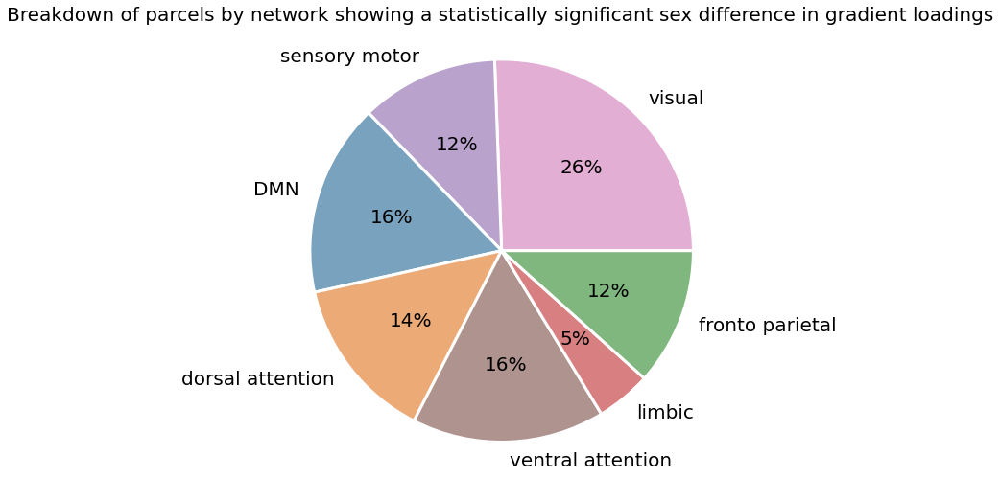

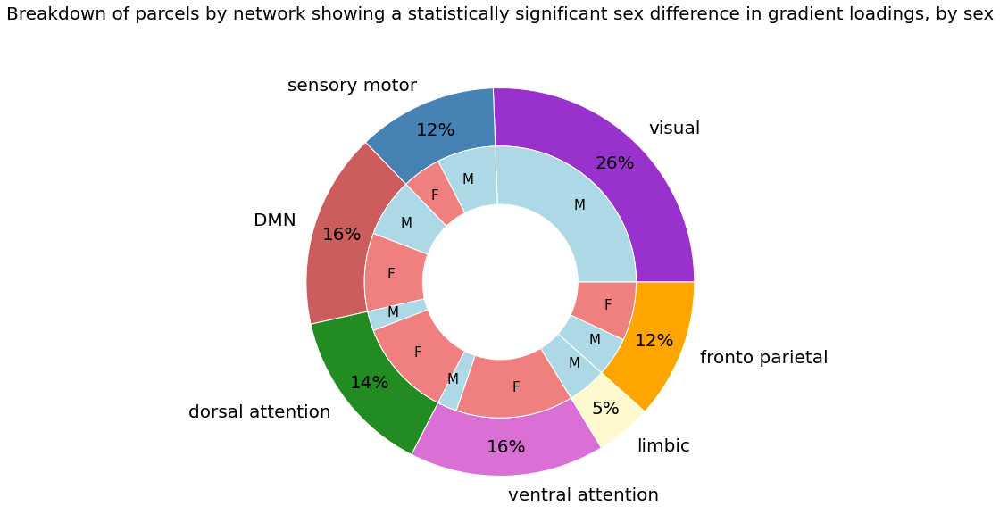

Number of significant parcels by sex:
visual - Male: 11, Female: 0
sensory motor - Male: 3, Female: 2
DMN - Male: 3, Female: 4
dorsal attention - Male: 1, Female: 5
ventral attention - Male: 1, Female: 6
limbic - Male: 2, Female: 0
fronto parietal - Male: 2, Female: 3





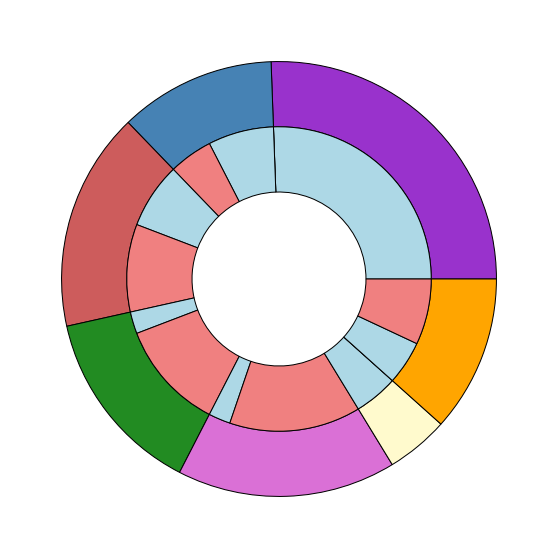




Violin plot of t-values (regression results) by Yeo network


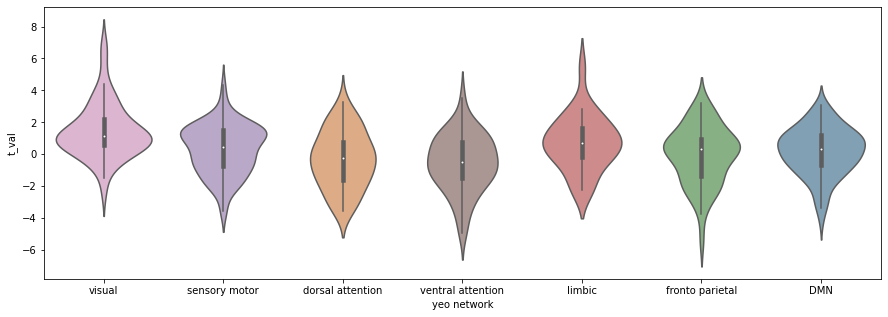

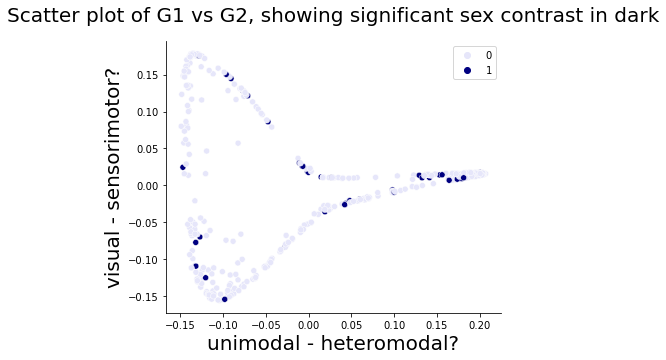

In [166]:
regression_contrast_results_breakdown_by_network(R_lmer_mpc_G1_sex_contrast_res, contrast_type = 'sex', 
                                                 scatter_x = mean_mpc_grad.gradients_[:,0], scatter_y = mean_mpc_grad.gradients_[:,1], 
                                                 scatter_x_label = 'unimodal - heteromodal?',  scatter_y_label = 'visual - sensorimotor?',
                                                 sample_modality = 'mpc_G1')

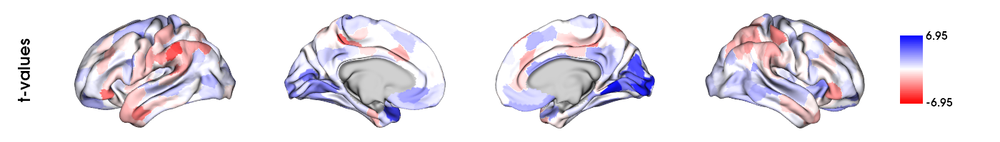

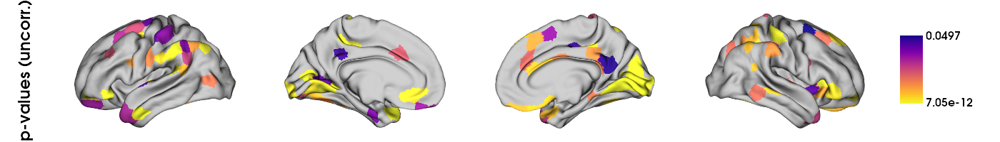

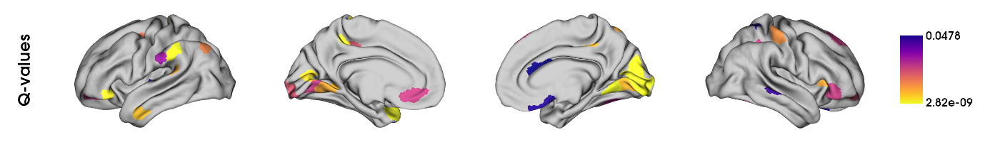

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

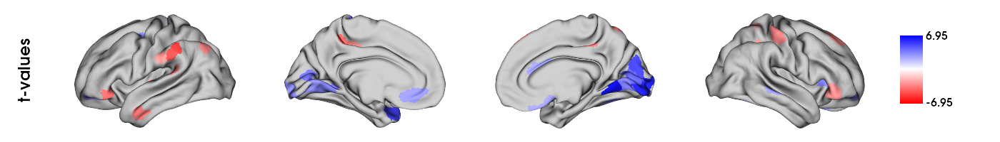

In [169]:
plots_to_display = plot_reg_results_R(R_lmer_mpc_G1_sex_contrast_res, contrast_type = 'sex', save_screenshot = False, sample_modality = 'HCP_mpc_G1')
display(*plots_to_display)

#
#
#
#
# Geodesic Distance

## Mean (group level) geodesic distance

In [56]:
mean_geodesic = np.array(sum(mean_geodesic_distances)/len(mean_geodesic_distances))

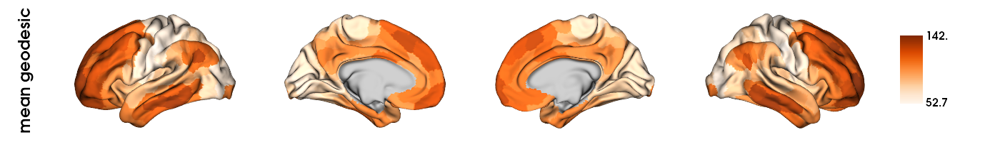

In [57]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()
mask = labeling != 0


mean_geodesic_mapped_to_labels = map_to_labels(mean_geodesic, labeling, mask=mask, fill=np.nan)  

mean_geodesic_plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_geodesic_mapped_to_labels, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = "Oranges",  
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean geodesic"],
    zoom = 1.45, 
    screenshot = False,
    filename = resdir_fig+'HCP_geo'+'_plotted_hemispheres_mean_distances.png'
)

mean_geodesic_plotted_hemispheres

## Mean (group level) geodesic distance by sex

In [58]:
# creating lists containing only male and only female fc matrices

mean_geodesic_distances_M = []
mean_geodesic_distances_F = []

for i in range(len(mean_geodesic_distances)):
    if HCP_demographics_cleaned_final.Gender.iloc[i] == "M":
        mean_geodesic_distances_M.append(mean_geodesic_distances[i])
    elif HCP_demographics_cleaned_final.Gender.iloc[i] == "F":
        mean_geodesic_distances_F.append(mean_geodesic_distances[i])
        
mean_geodesic_distances_M = np.array(mean_geodesic_distances_M)
mean_geodesic_distances_F = np.array(mean_geodesic_distances_F)

### Males

In [59]:
mean_geodesic_M = np.array(sum(mean_geodesic_distances_M)/len(mean_geodesic_distances_M))

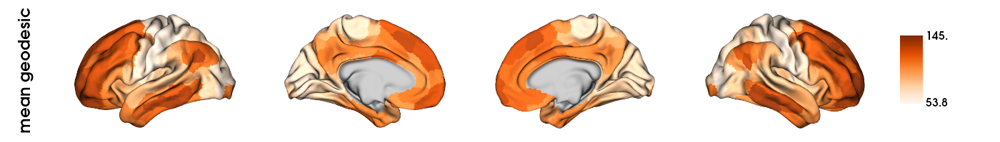

In [60]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()
mask = labeling != 0


mean_geodesic_mapped_to_labels = map_to_labels(mean_geodesic_M, labeling, mask=mask, fill=np.nan)  

mean_geodesic_plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_geodesic_mapped_to_labels, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = "Oranges",  
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean geodesic"],
    zoom = 1.45, 
    screenshot = False,
    filename = resdir_fig+'HCP_geo'+'_plotted_hemispheres_mean_distances_M.png'
)

mean_geodesic_plotted_hemispheres

### Females

In [61]:
mean_geodesic_F = np.array(sum(mean_geodesic_distances_F)/len(mean_geodesic_distances_F))

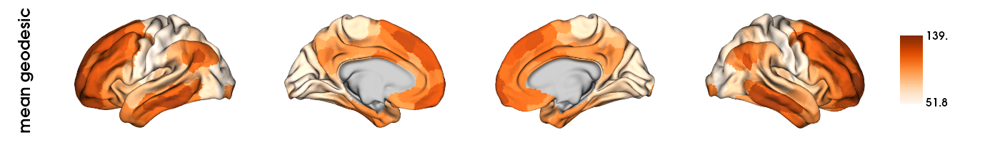

In [62]:
# defining labeling scheme and mask
labeling = load_parcellation('schaefer', scale=400, join=True)
surf_lh, surf_rh = load_conte69()
mask = labeling != 0


mean_geodesic_mapped_to_labels = map_to_labels(mean_geodesic_F, labeling, mask=mask, fill=np.nan)  

mean_geodesic_plotted_hemispheres = plot_hemispheres(
    surf_lh, 
    surf_rh, 
    array_name = mean_geodesic_mapped_to_labels, 
    embed_nb = True, 
    size = (1400,200), 
    cmap = "Oranges",  
    color_bar = True, 
    #color_range='sym',
    nan_color = (0.7, 0.7, 0.7, 1),
    label_text = ["mean geodesic"],
    zoom = 1.45, 
    screenshot = False,
    filename = resdir_fig+'HCP_geo'+'_plotted_hemispheres_mean_distances_F.png'
)

mean_geodesic_plotted_hemispheres

### Geodesic distance by network by sex

In [63]:
df_geo_networks_M = pd.DataFrame({'geodesic distance':  mean_geodesic_M,  'sex': ['M']*len(mean_geodesic_M), 'Yeo 7 networks' : yeo7_networks_array_labels})
df_geo_networks_F = pd.DataFrame({'geodesic distance':  mean_geodesic_F, 'sex': ['F']*len(mean_geodesic_F), 'Yeo 7 networks' : yeo7_networks_array_labels})
df_geo_networks = pd.concat([df_geo_networks_M, df_geo_networks_F])

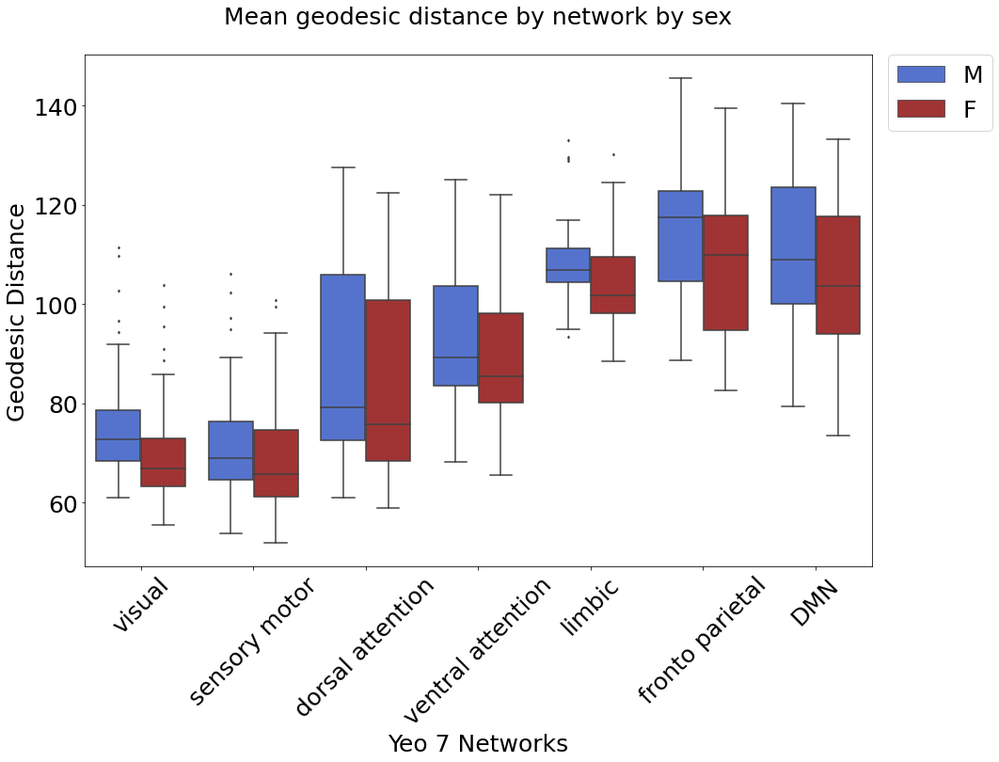

In [86]:
colors = {'F':'firebrick', 'M':'royalblue'}

fig, ax = plt.subplots(figsize=(15, 10))


sns.boxplot(data=df_geo_networks, x='Yeo 7 networks', y='geodesic distance', hue='sex', palette = colors, fliersize = 2) 



ax.axes.set_title(f"Mean geodesic distance by network by sex", y=1.05, fontsize=25)
ax.set_xlabel("Yeo 7 Networks",fontsize=25)
ax.set_ylabel("Geodesic Distance",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)
plt.xticks(rotation=45)
plt.show()

# Variability (individual- and sex-level) in gradient values

## 2. Parcel level: Visualizing standard deviation by parcels in both sexes separately

To visualize which sex and parcels have most variability

Number of parcels for which there males have a statistically significant larger variance than females: 113
Number of parcels for which there females have a statistically significant larger variance than males: 3
Number of parcels for which there males have a statistically significant larger variance than females after FDR-correction: 50
Number of parcels for which there females have a statistically significant larger variance than males after FDR-correction: 1

Minimum SD: Males = 5.816; Females = 5.424
Maximum SD: Males = 28.019; Females = 27.002


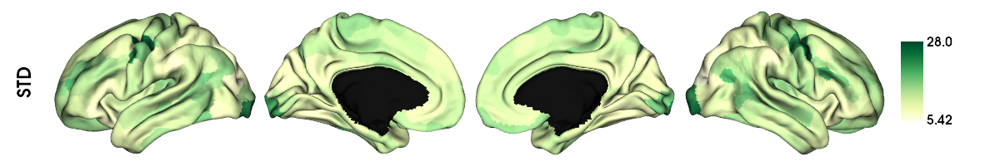

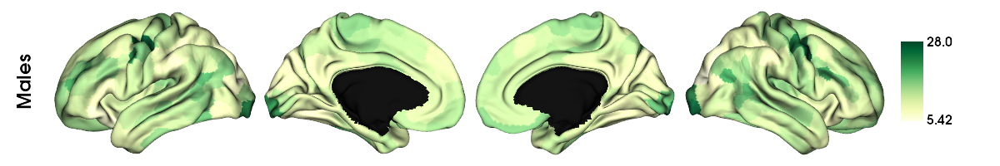

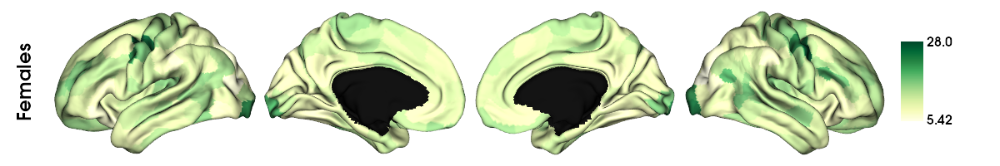

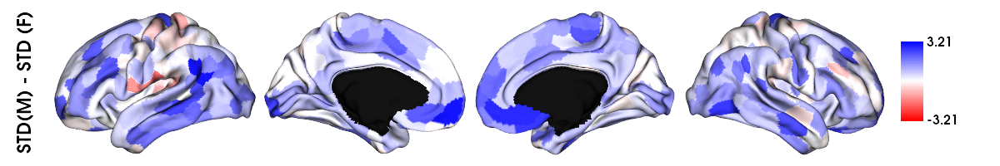

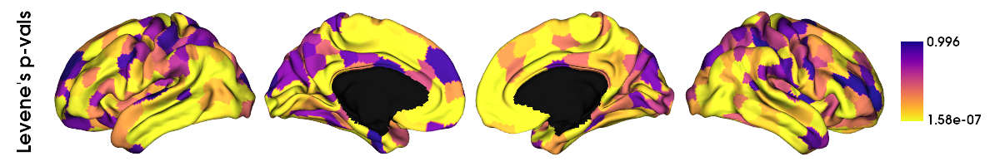

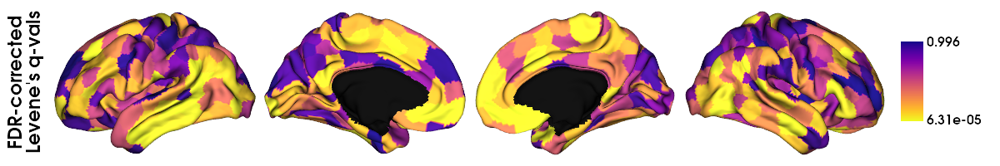

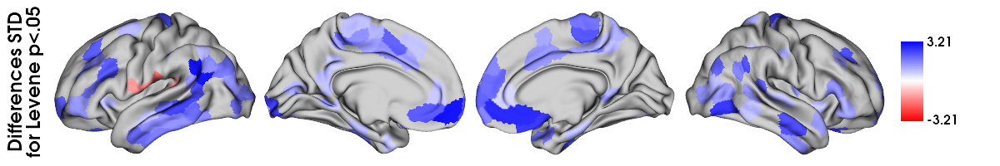

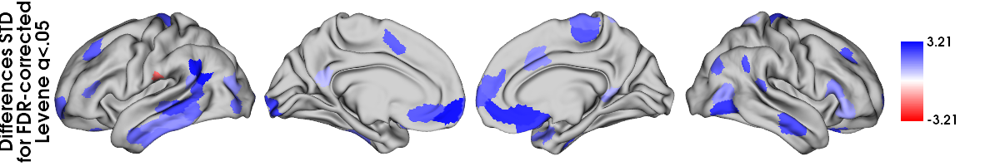

Number of significant parcels: 51

Number of significant parcels for males: 50
Number of significant parcels for females: 1

Number of significant parcels in each Yeo network (across sexes):
- visual: 7 out of 61 (11.48%) -> 13.73% of overall significance
- sensory motor: 8 out of 77 (10.39%) -> 15.69% of overall significance
- DMN: 21 out of 90 (23.33%) -> 41.18% of overall significance
- dorsal attention: 1 out of 46 (2.17%) -> 1.96% of overall significance
- ventral attention: 3 out of 47 (6.38%) -> 5.88% of overall significance
- limbic: 8 out of 26 (30.77%) -> 15.69% of overall significance
- fronto parietal: 3 out of 53 (5.66%) -> 5.88% of overall significance





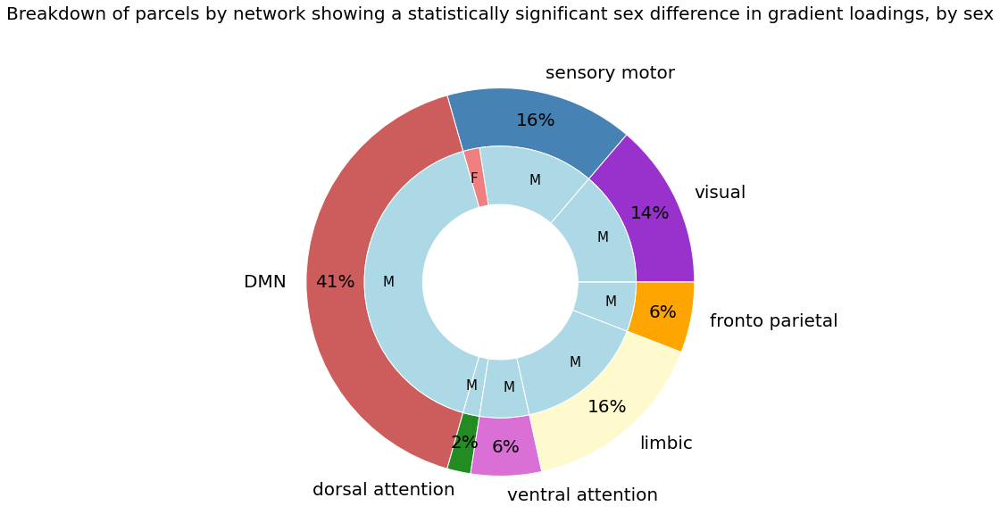

Number of significant parcels by sex:
visual - Male: 7, Female: 0
sensory motor - Male: 7, Female: 1
DMN - Male: 21, Female: 0
dorsal attention - Male: 1, Female: 0
ventral attention - Male: 3, Female: 0
limbic - Male: 8, Female: 0
fronto parietal - Male: 3, Female: 0





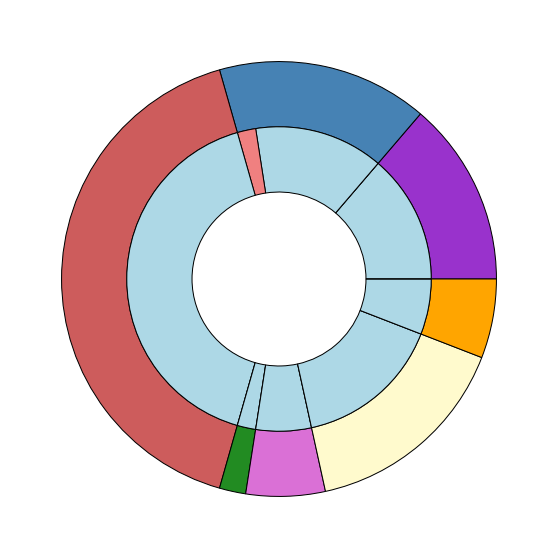

In [79]:
variability_parcel_std(subject_grad = mean_geodesic_distances, subject_grad_M = mean_geodesic_distances_M, subject_grad_F = mean_geodesic_distances_F, save_plots = False, sample_modality = 'HCP_geo')

# Sex effects mean geodesic distance (standard linear regression - FDR-corrected)

In [171]:
# loading R results

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + ICV + random nested effect (family relatedness/twin status) 
R_lmer_geo_sex_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_geo_sex_contrast_res.csv')  

Number of significant parcels: 133

Number of significant parcels for males: 116
Number of significant parcels for females: 17

Number of significant parcels in each Yeo network (across sexes):
- visual: 33 out of 61 (54.1%) -> 24.81% of overall significance
- sensory motor: 20 out of 77 (25.97%) -> 15.04% of overall significance
- DMN: 32 out of 90 (35.56%) -> 24.06% of overall significance
- dorsal attention: 6 out of 46 (13.04%) -> 4.51% of overall significance
- ventral attention: 17 out of 47 (36.17%) -> 12.78% of overall significance
- limbic: 6 out of 26 (23.08%) -> 4.51% of overall significance
- fronto parietal: 19 out of 53 (35.85%) -> 14.29% of overall significance





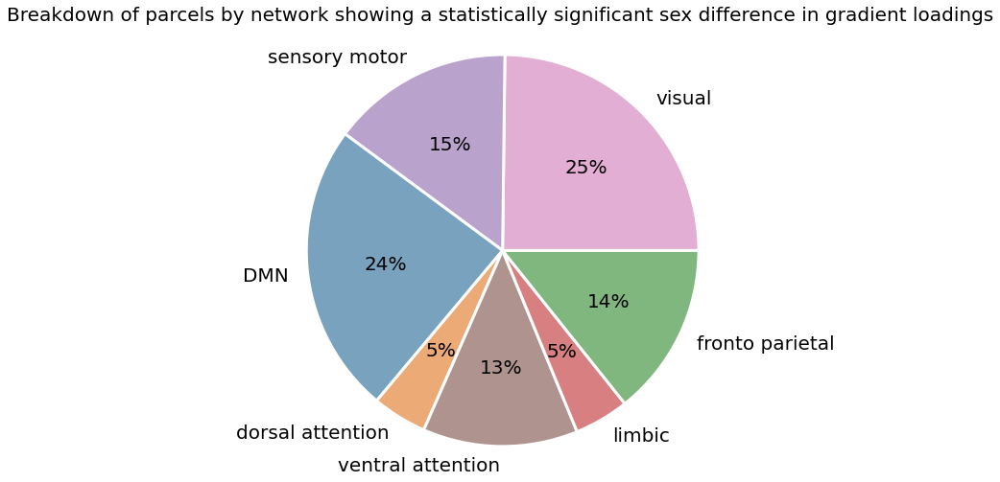

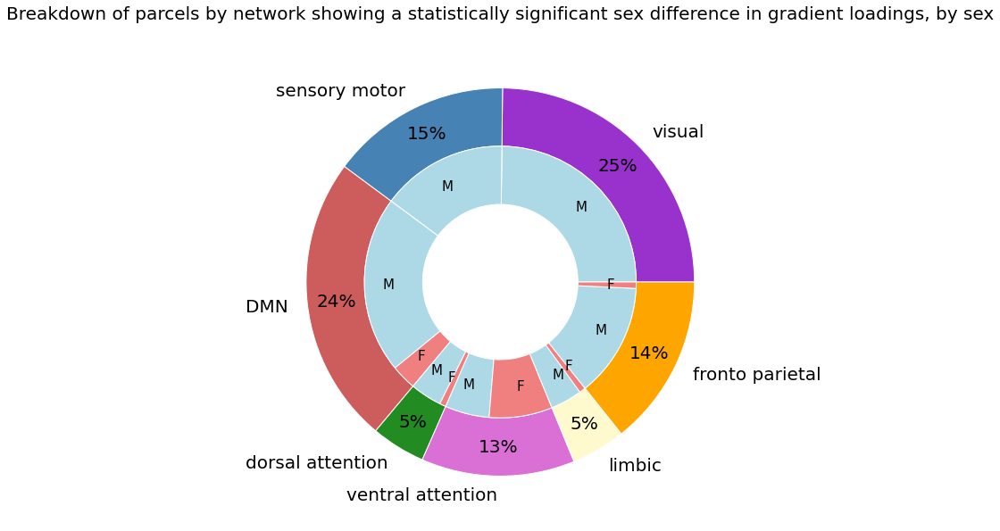

Number of significant parcels by sex:
visual - Male: 33, Female: 0
sensory motor - Male: 20, Female: 0
DMN - Male: 28, Female: 4
dorsal attention - Male: 5, Female: 1
ventral attention - Male: 7, Female: 10
limbic - Male: 5, Female: 1
fronto parietal - Male: 18, Female: 1





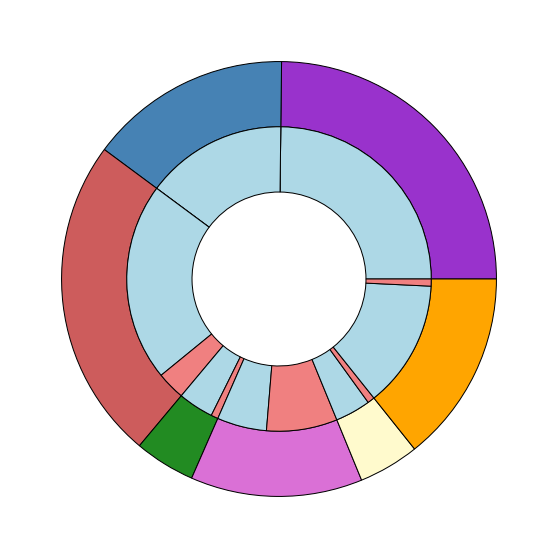




Violin plot of t-values (regression results) by Yeo network


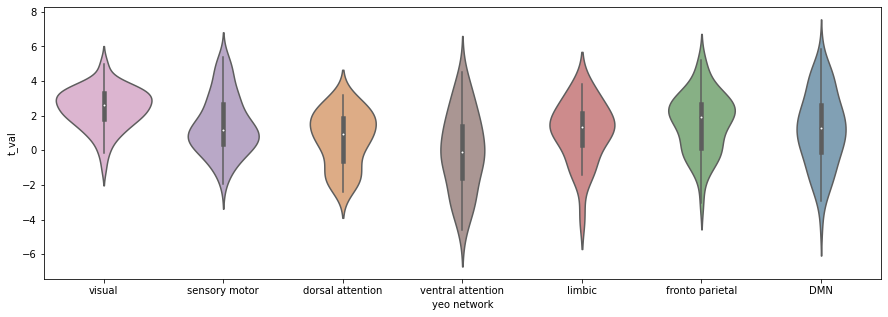

In [172]:
regression_contrast_results_breakdown_by_network(R_lmer_geo_sex_contrast_res, contrast_type = 'sex', 
                                                 scatterplot = False,
                                                 sample_modality = 'HCP_geo')

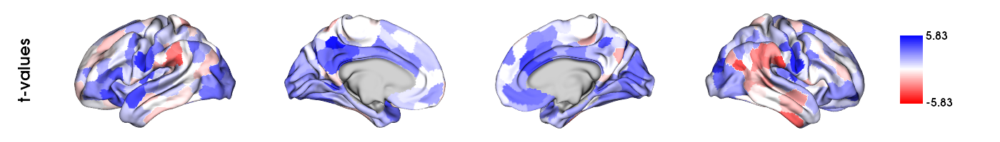

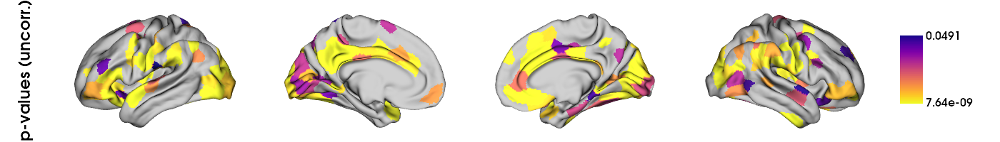

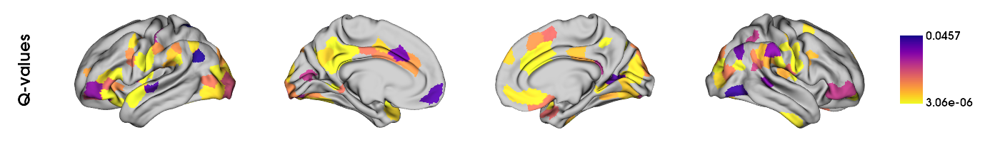

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

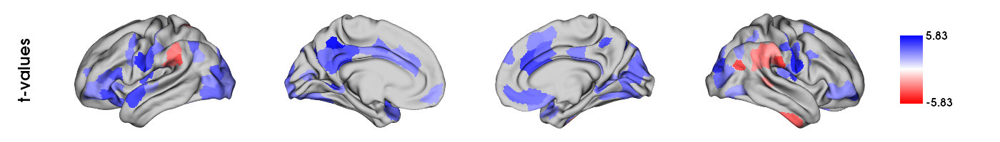

In [173]:
plots_to_display = plot_reg_results_R(R_lmer_geo_sex_contrast_res, contrast_type = 'sex', save_screenshot = False, sample_modality = 'HCP_geo')
display(*plots_to_display)

#
#
#
#
# Structural explanations of FC gradient

## Brain size effects on FC G1

### Sex differences in brain size and variability in brain size

In [29]:
print(f"Mean ICV across sexes: {np.mean(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f}, SD: {np.std(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f}, range: {np.min(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f} - {np.max(HCP_demographics_cleaned_final.FS_IntraCranial_Vol):.2f}")
print(f"Mean ICV in males: {np.mean(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'M'].FS_IntraCranial_Vol)):.2f}, SD: {np.std(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'M'].FS_IntraCranial_Vol)):.2f}, range: {np.min(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'M'].FS_IntraCranial_Vol)):.2f} - {np.max(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'M'].FS_IntraCranial_Vol)):.2f}")
print(f"Mean ICV in females: {np.mean(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'F'].FS_IntraCranial_Vol)):.2f}, SD: {np.std(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'F'].FS_IntraCranial_Vol)):.2f}, range: {np.min(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'F'].FS_IntraCranial_Vol)):.2f} - {np.max(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'F'].FS_IntraCranial_Vol)):.2f}")

Mean ICV across sexes: 1584000.48, SD: 187267.82, range: 831208.30 - 2143193.92
Mean ICV in males: 1710346.08, SD: 140913.06, range: 1073654.78 - 2143193.92
Mean ICV in females: 1474626.68, SD: 149856.43, range: 831208.30 - 1887692.73


Equal variances (so don't take female STD > male STD as meaningful, although interesting descriptive trend)

In [30]:
stats.levene(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'M'].FS_IntraCranial_Vol), np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'F'].FS_IntraCranial_Vol))

LeveneResult(statistic=0.17555680280673508, pvalue=0.6753099535260523)

Statistically significant brain sizes between sexes

In [31]:
stats.ttest_ind(np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'M'].FS_IntraCranial_Vol), np.array(HCP_demographics_cleaned_final.loc[HCP_demographics_cleaned_final.Gender == 'F'].FS_IntraCranial_Vol))

Ttest_indResult(statistic=25.475286615320904, pvalue=1.0993779813780877e-110)

### Standard linear regression - (FDR-corrected)

In [55]:
# loading R results

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + ICV + random nested effect (family relatedness/twin status) 
R_lmer_fc_G1_icv_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_fc_G1_icv_contrast_res.csv')  

Number of significant parcels: 4

Number of significant parcels for males: 1
Number of significant parcels for females: 3

Number of significant parcels in each Yeo network (across sexes):
- visual: 1 out of 61 (1.64%) -> 25.0% of overall significance
- sensory motor: 0 out of 77 (0.0%) -> 0.0% of overall significance
- DMN: 2 out of 90 (2.22%) -> 50.0% of overall significance
- dorsal attention: 0 out of 46 (0.0%) -> 0.0% of overall significance
- ventral attention: 0 out of 47 (0.0%) -> 0.0% of overall significance
- limbic: 0 out of 26 (0.0%) -> 0.0% of overall significance
- fronto parietal: 1 out of 53 (1.89%) -> 25.0% of overall significance





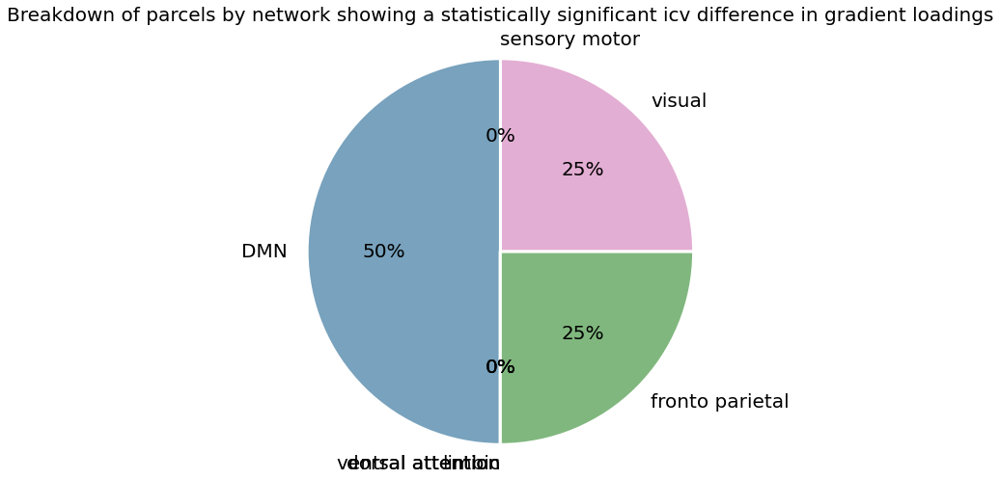

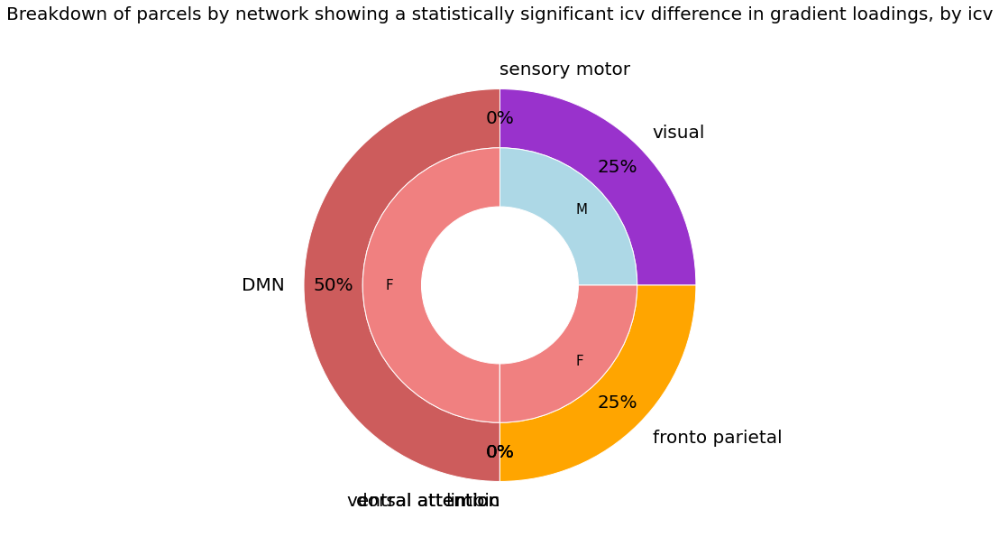

Number of significant parcels by sex:
visual - Male: 1, Female: 0
sensory motor - Male: 0, Female: 0
DMN - Male: 0, Female: 2
dorsal attention - Male: 0, Female: 0
ventral attention - Male: 0, Female: 0
limbic - Male: 0, Female: 0
fronto parietal - Male: 0, Female: 1





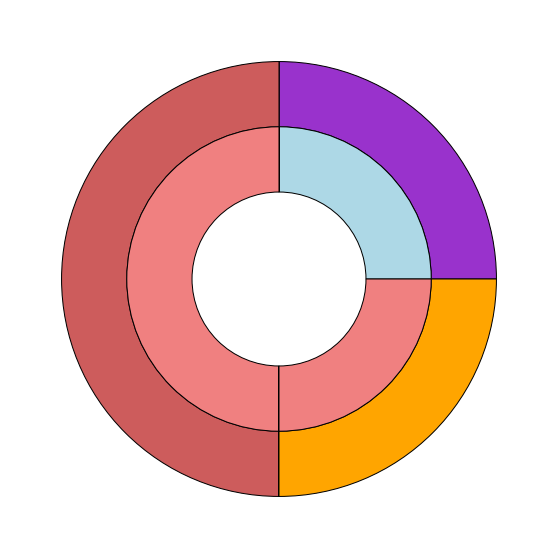




Violin plot of t-values (regression results) by Yeo network


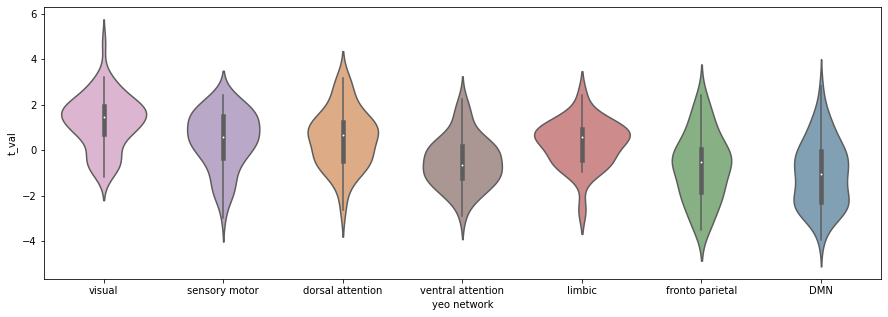

In [56]:
regression_contrast_results_breakdown_by_network(R_lmer_fc_G1_icv_contrast_res, contrast_type = 'icv', 
                                                 scatterplot = False,
                                                 sample_modality = 'HCP_fc_G1')

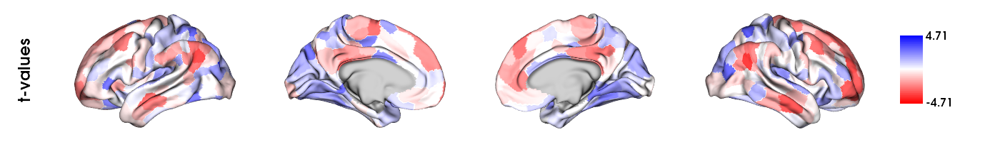

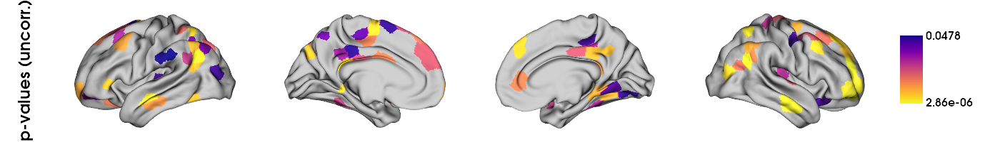

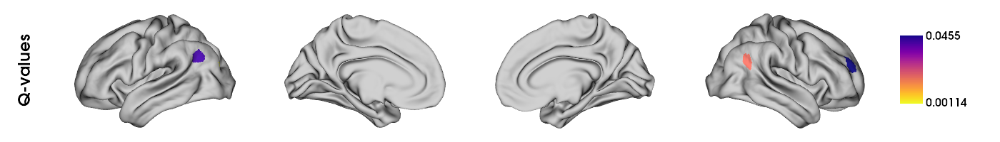

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

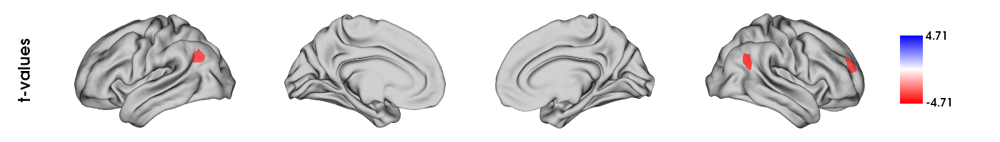

In [59]:
plots_to_display = plot_reg_results_R(R_lmer_fc_G1_icv_contrast_res, contrast_type = 'icv', save_screenshot = False, sample_modality = 'HCP_fc_G1')
display(*plots_to_display)

## Structure (MPC G1) - Function (FC G1) Covariance

-> conclusion: MPC doesn't seem to explain functional macroscale organization

In [90]:
stats.spearmanr(mean_mpc_grad.gradients_[:,0], mean_fc_grad.gradients_[:,0])

SpearmanrResult(correlation=0.21637916486978043, pvalue=1.2661818130196403e-05)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.038


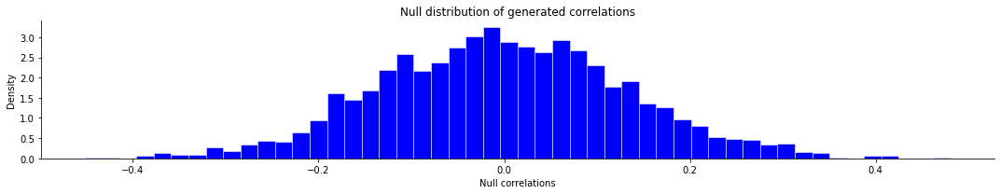

In [91]:
SpinPermutationTest_Schaefer400(x = mean_mpc_grad.gradients_[:,0], y =  mean_fc_grad.gradients_[:,0], correlation_type = 'spearman')

<AxesSubplot:title={'center':'MPC G1 vs FC G1'}, xlabel='MPC', ylabel='FC'>

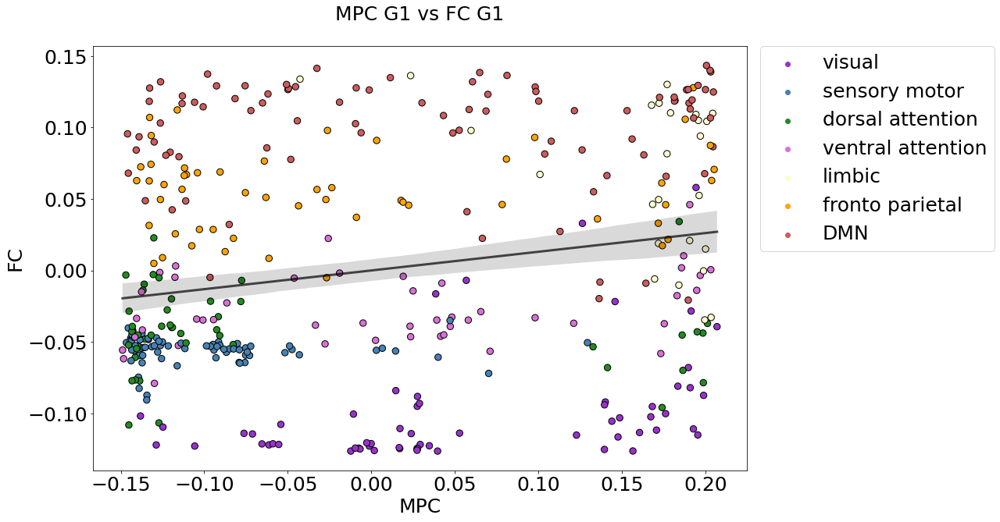

In [92]:
# make a dataframe containing the mpc and fc data (to make it plottable)
dataframe = pd.DataFrame({'MPC':  mean_mpc_grad.gradients_[:,0], 'FC': mean_fc_grad.gradients_[:,0]})


# plot figure
fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = dataframe, x = 'MPC', y = 'FC', 
                hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

ax.axes.set_title(f"MPC G1 vs FC G1", y=1.05, fontsize=25)
ax.set_xlabel("MPC G1",fontsize=25)
ax.set_ylabel("FC G1",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)


sns.regplot(data=dataframe, x = 'MPC', y = 'FC', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

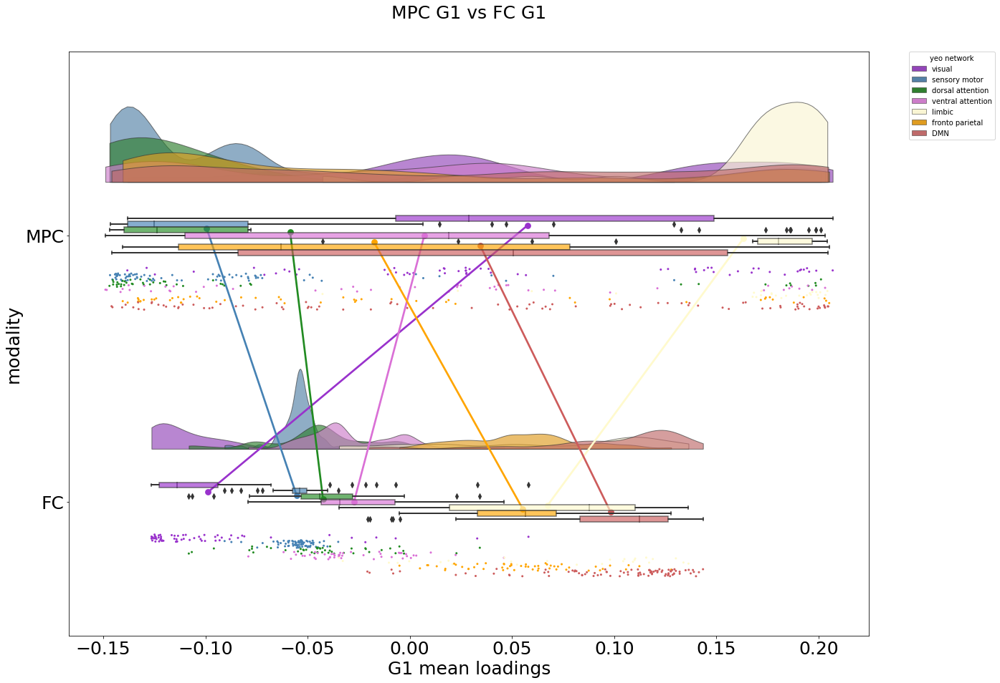

In [93]:
# make a dataframe containing the mpc and fc data (to make it plottable)
dataframe = pd.DataFrame({'MPC':  mean_mpc_grad.gradients_[:,0], 'FC': mean_fc_grad.gradients_[:,0]})

# make it long
dataframe_long = pd.melt(dataframe, value_vars = ['MPC', 'FC'] ,value_name = 'G1 mean loadings', var_name = 'modality', ignore_index = True)

# add the yeo network labels
dataframe_long['yeo network'] = list(yeo7_networks_array_labels)*2

## plot 

f,ax=plt.subplots(figsize=(20,15))

ax=pt.RainCloud(x="modality",
                y="G1 mean loadings",
                hue="yeo network",
                data=dataframe_long,
                palette=palette_labeled_networks,
                bw=.2,
                width_viol=.6,
                orient="h",
                move=.2,
                alpha=.65,
                pointplot=True, 
                dodge = True)


ax.axes.set_title(f"MPC G1 vs FC G1", y=1.05, fontsize=25)
ax.set_xlabel("G1 mean loadings",fontsize=25)
ax.set_ylabel("modality",fontsize=25)
ax.tick_params(labelsize=25)

## Geodesic distance underpinnings of functional macroscale organization (FC G1) 

### Correlations of FC G1 and geodesic distance values (comparison of patterns in variables)

In [94]:
stats.spearmanr(mean_fc_grad.gradients_[:,0], mean_geodesic)

SpearmanrResult(correlation=0.73998706241914, pvalue=1.5284932847730976e-70)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.004


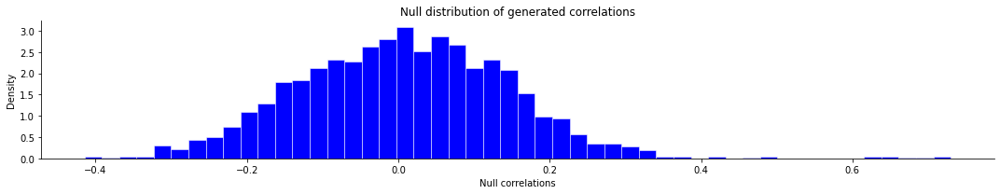

In [95]:
SpinPermutationTest_Schaefer400(x = mean_fc_grad.gradients_[:,0], y = mean_geodesic, correlation_type = 'spearman')

In [96]:
df_fc_geo = pd.DataFrame({'FC': mean_fc_grad.gradients_[:,0], 'geodesic distance':  mean_geodesic, 'yeo7_networks_array_labels' : yeo7_networks_array_labels})

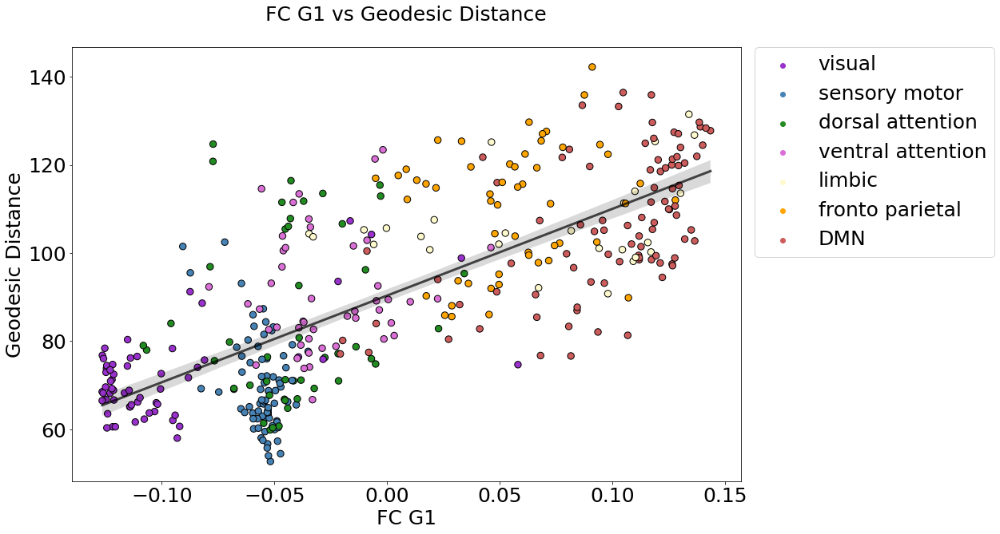

In [97]:
fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df_fc_geo, x = 'FC', y = 'geodesic distance', 
                hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df_fc_geo, x = 'FC', y = 'geodesic distance', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})


ax.axes.set_title(f"FC G1 vs Geodesic Distance", y=1.05, fontsize=25)
ax.set_xlabel("FC G1",fontsize=25)
ax.set_ylabel("Geodesic Distance",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

Note that the correlation p-values below have not undergone permutation testing! so here the correlations (r coefficients) are only indicative of effect sizes


Overall Pearson correlation between FC G1 and mean geodesic distance: r = 0.73; p = 0.0

visual: r = 0.6, p = 0.0
sensory motor: r = -0.43, p = 0.0
dorsal attention: r = 0.11, p = 0.454
ventral attention: r = 0.09, p = 0.55
limbic: r = 0.28, p = 0.161
fronto parietal: r = 0.18, p = 0.2
DMN: r = 0.58, p = 0.0




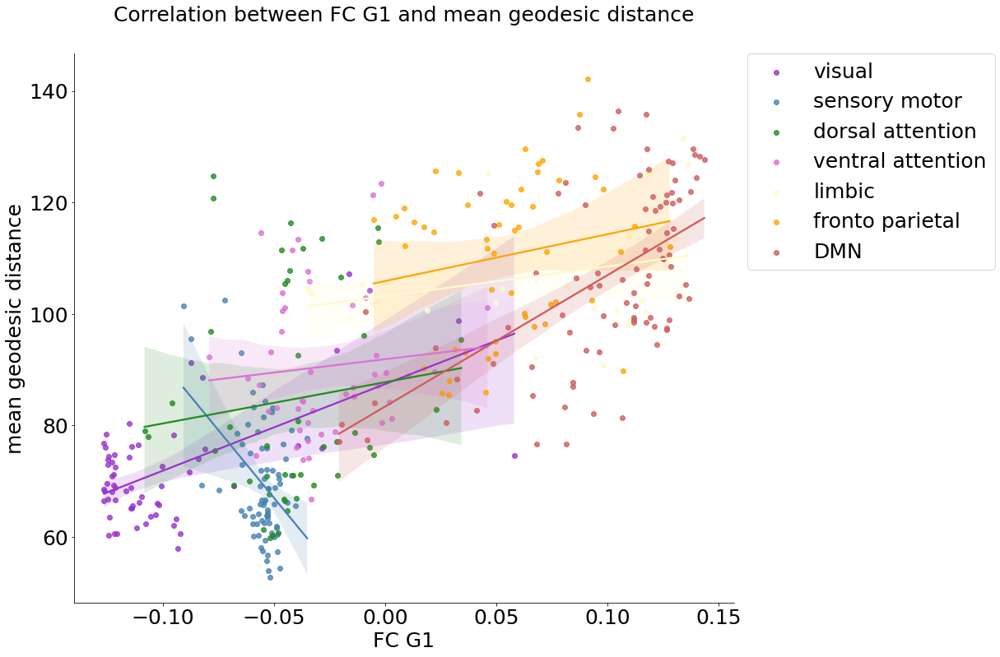

In [98]:
print_plot_corr_networks(x = mean_fc_grad.gradients_[:,0], y = mean_geodesic, x_label = 'FC G1', y_label = 'mean geodesic distance')

### Geodesic distance effect on FG G1 loadings (Standard linear regression - FDR-corrected)

In [60]:
# loading R results

# HCP model: linear mixed effects model = Gradient_loadings ~ Sex + Age + ICV + mean geodesic distance + random nested effect (family relatedness/twin status) 
R_lmer_fc_G1_geo_contrast_res = pd.read_csv(resdir_hcp+'R_lmer_fc_G1_geo_contrast_res.csv')  

Number of significant parcels: 337

Number of significant parcels for males: 154
Number of significant parcels for females: 183

Number of significant parcels in each Yeo network (across sexes):
- visual: 46 out of 61 (75.41%) -> 13.65% of overall significance
- sensory motor: 74 out of 77 (96.1%) -> 21.96% of overall significance
- DMN: 73 out of 90 (81.11%) -> 21.66% of overall significance
- dorsal attention: 42 out of 46 (91.3%) -> 12.46% of overall significance
- ventral attention: 39 out of 47 (82.98%) -> 11.57% of overall significance
- limbic: 22 out of 26 (84.62%) -> 6.53% of overall significance
- fronto parietal: 41 out of 53 (77.36%) -> 12.17% of overall significance





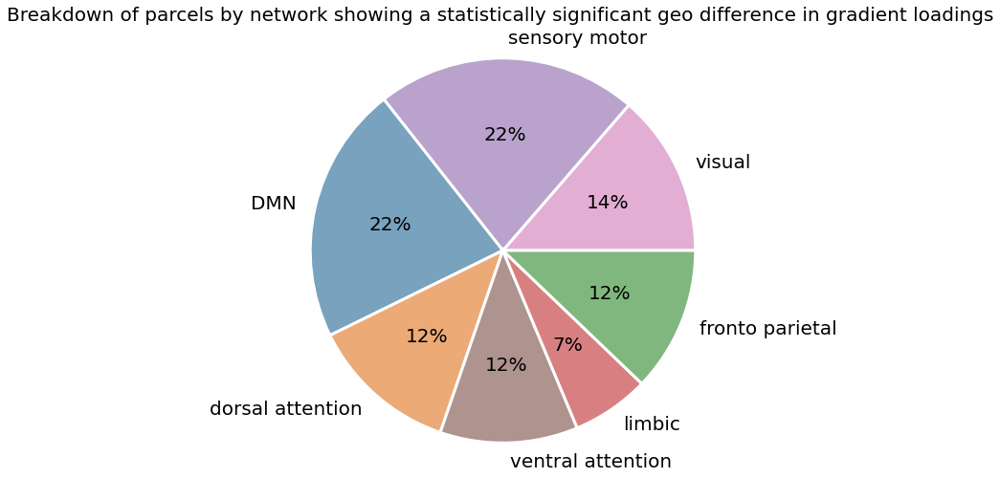

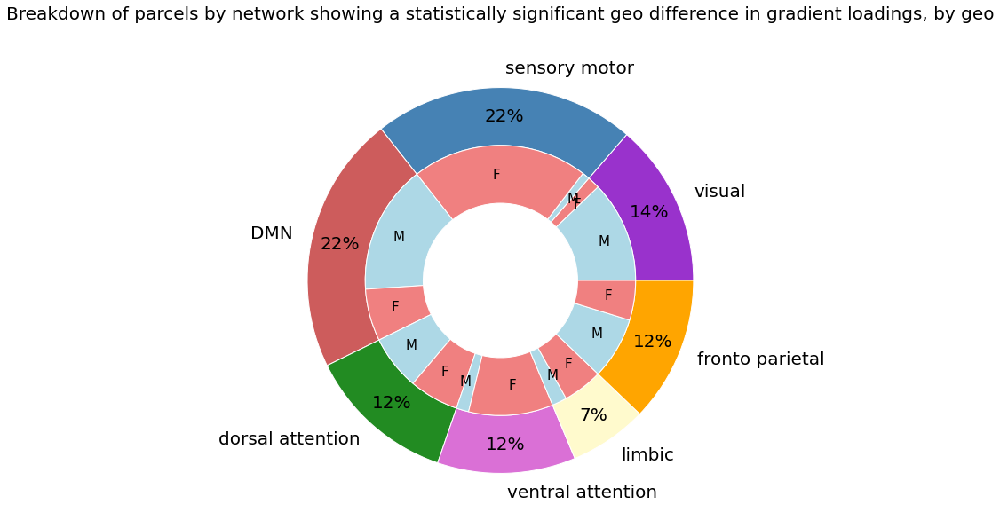

Number of significant parcels by sex:
visual - Male: 41, Female: 5
sensory motor - Male: 3, Female: 71
DMN - Male: 52, Female: 21
dorsal attention - Male: 22, Female: 20
ventral attention - Male: 5, Female: 34
limbic - Male: 6, Female: 16
fronto parietal - Male: 25, Female: 16





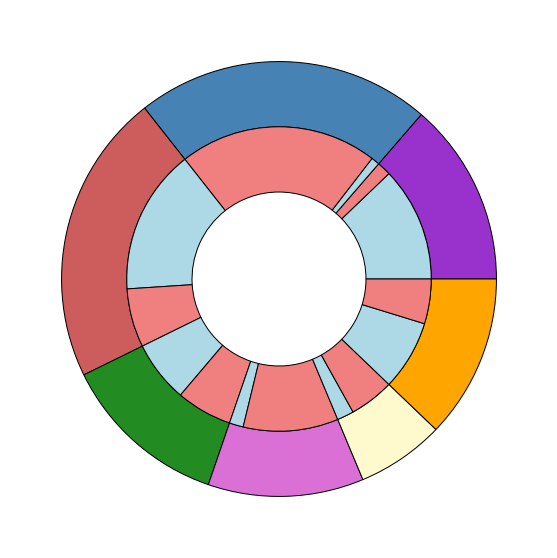




Violin plot of t-values (regression results) by Yeo network


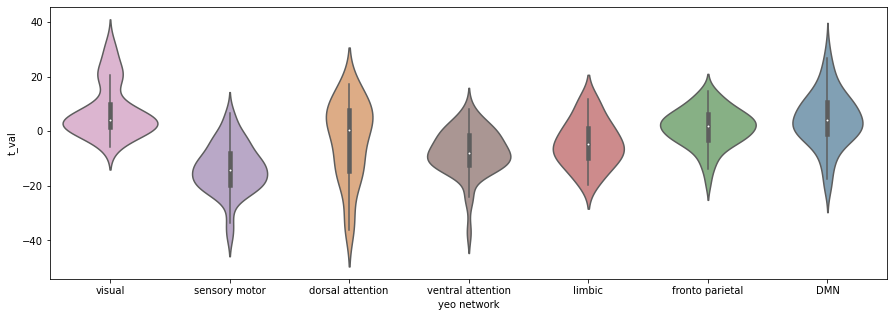

In [61]:
regression_contrast_results_breakdown_by_network(R_lmer_fc_G1_geo_contrast_res, contrast_type = 'geo', 
                                                 scatterplot = False,
                                                 sample_modality = 'HCP_fc_G1')

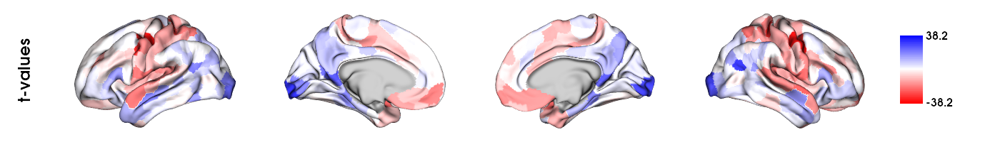

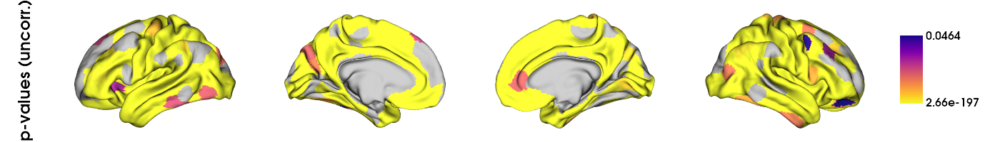

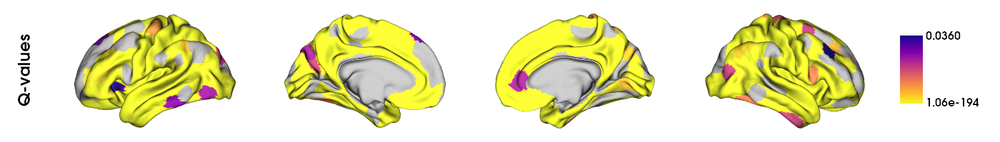

't-values for FDR-corrected q < 0.05: (male: blue, female: red)'

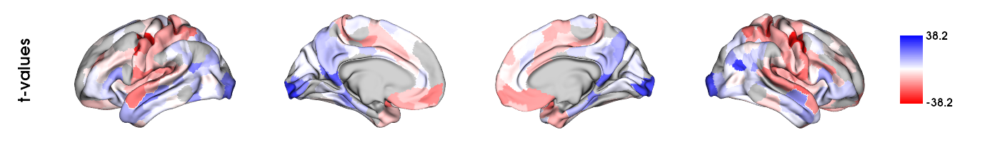

In [64]:
plots_to_display = plot_reg_results_R(R_lmer_fc_G1_geo_contrast_res, contrast_type = 'geo', save_screenshot = False, sample_modality = 'HCP_fc_G1')
display(*plots_to_display)

### Correlations of FC G1 and geodesic distance t-maps (comparison of patterns in sex differences in variables)

In [99]:
stats.spearmanr(R_lmer_fc_G1_sex_contrast_res.t_val_sex, R_lmer_geo_sex_contrast_res.t_val_sex)

SpearmanrResult(correlation=-0.024589091181819886, pvalue=0.6239096463156805)

permutation 100 of 1000
permutation 200 of 1000
permutation 300 of 1000
permutation 400 of 1000
permutation 500 of 1000
permutation 600 of 1000
permutation 700 of 1000
permutation 800 of 1000
permutation 900 of 1000
permutation 1000 of 1000
Spin permutation test p-value: 0.512


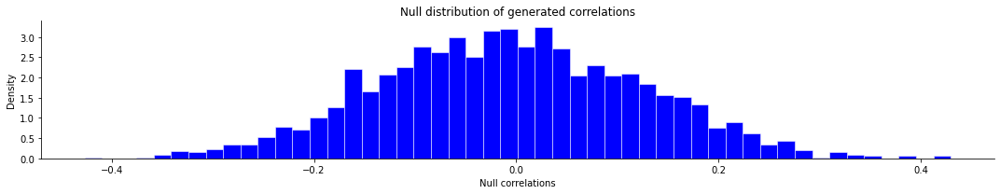

In [100]:
SpinPermutationTest_Schaefer400(x = R_lmer_fc_G1_sex_contrast_res.t_val_sex, y = R_lmer_geo_sex_contrast_res.t_val_sex, correlation_type = 'spearman')

In [101]:
df_fc_geo_t = pd.DataFrame({'FC': R_lmer_fc_G1_sex_contrast_res.t_val_sex, 'geodesic distance':  R_lmer_geo_sex_contrast_res.t_val_sex, 'yeo7_networks_array_labels' : yeo7_networks_array_labels})

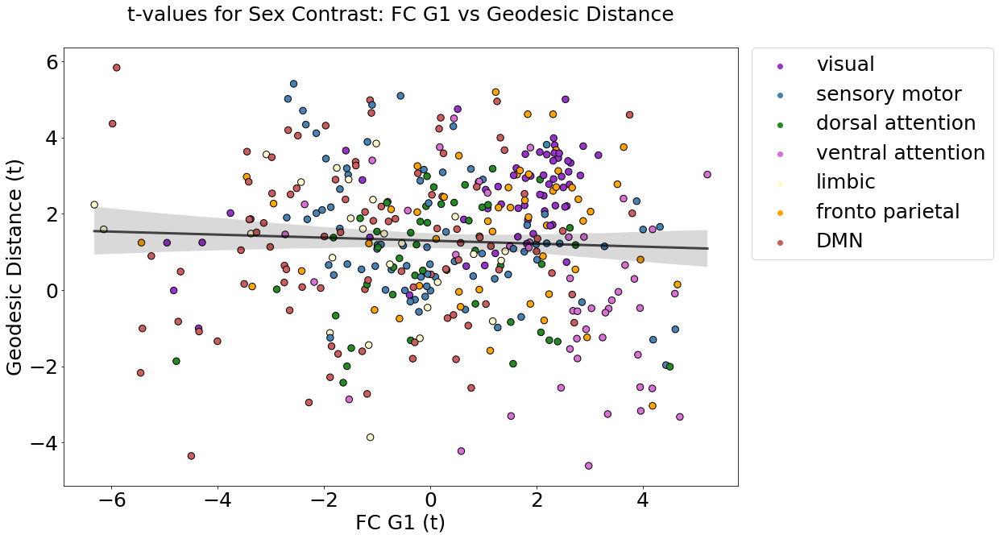

In [102]:
fig, ax = plt.subplots(figsize=(15, 10))

sns.scatterplot(data = df_fc_geo_t, x = 'FC', y = 'geodesic distance', 
                hue=yeo7_networks_array_labels,  # gives color coding based on yeo networks
                palette=palette_labeled_networks, 
                s=70, 
                edgecolor='black',
                linewidth=1)

sns.regplot(data=df_fc_geo_t, x = 'FC', y = 'geodesic distance', scatter=False, ax=ax, line_kws={"color":"black","alpha":0.7,"lw":3})

ax.axes.set_title(f"t-values for Sex Contrast: FC G1 vs Geodesic Distance", y=1.05, fontsize=25)
ax.set_xlabel("FC G1 (t)",fontsize=25)
ax.set_ylabel("Geodesic Distance (t)",fontsize=25)
ax.tick_params(labelsize=25)
ax.legend(fontsize=25, bbox_to_anchor=(1.02, 1), loc='upper left', borderaxespad=0)

Note that the correlation p-values below have not undergone permutation testing! so here the correlations (r coefficients) are only indicative of effect sizes


Overall Pearson correlation between FC G1 t-values and mean geodesic distance t-values: r = -0.05; p = 0.348

visual: r = 0.52, p = 0.0
sensory motor: r = -0.39, p = 0.001
dorsal attention: r = 0.09, p = 0.564
ventral attention: r = -0.32, p = 0.028
limbic: r = -0.31, p = 0.129
fronto parietal: r = 0.04, p = 0.774
DMN: r = 0.09, p = 0.426




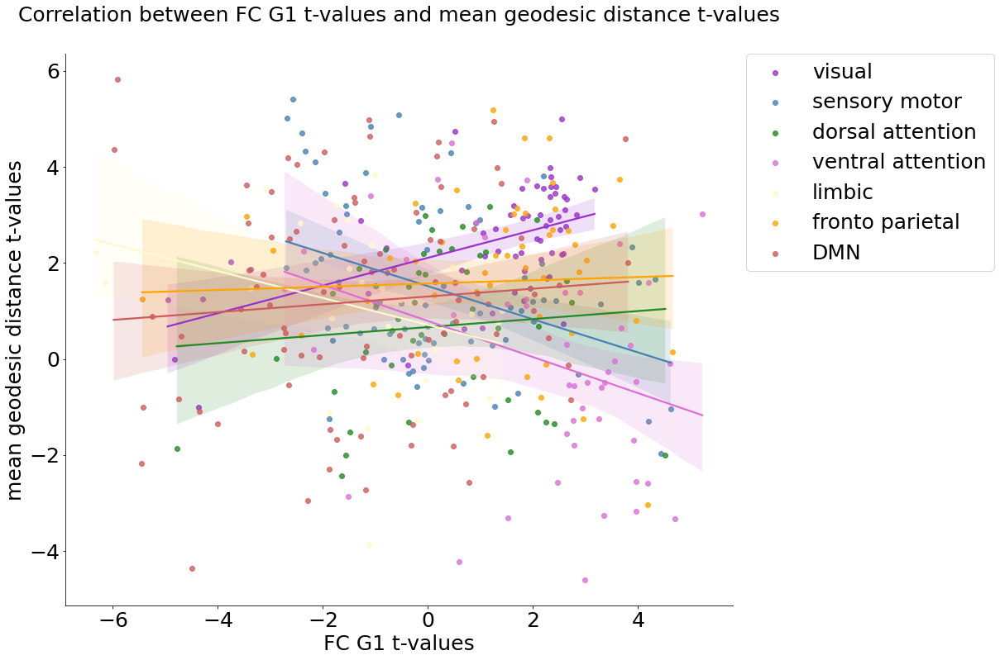

In [103]:
print_plot_corr_networks(x = R_lmer_fc_G1_sex_contrast_res.t_val_sex, y = R_lmer_geo_sex_contrast_res.t_val_sex, x_label = 'FC G1 t-values', y_label = 'mean geodesic distance t-values')